In [1]:
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.utils.data import Dataset, DataLoader, SequentialSampler, RandomSampler
from torchvision import transforms as T
from torchsummary import summary

from tqdm.notebook import tqdm
from skimage.color import lab2rgb, rgb2lab
import numpy as np
from matplotlib import pyplot as plt
import os 
import cv2
import glob
from sklearn.model_selection import train_test_split

# Unet block

In [2]:
class UnetBlock(nn.Module):
    def __init__(
        self, nf, ni, submodule=None, input_c=None, dropout=False,
        innermost=False, outermost=False
    ):
        super(UnetBlock, self).__init__()
        self.outermost = outermost
        if input_c is None:
            input_c = nf
            
        downconv = nn.Conv2d(
            input_c, ni, kernel_size=4,
            stride=2, padding=1, bias=False
        )
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)
        
        if outermost:
            upconv = nn.ConvTranspose2d(
                ni * 2, nf, kernel_size=4,
                stride=2, padding=1
            )
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(
                ni, nf, kernel_size=4,
                stride=2, padding=1, bias=False
            )
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(
                ni * 2, nf, kernel_size=4,
                stride=2, padding=1, bias=False
            )
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout:
                up += [nn.Dropout(0.5)]
            
            model = down + [submodule] + up
            
        self.model = nn.Sequential(*model)
        
    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

In [3]:
class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super(Unet, self).__init__()
        unet_block = UnetBlock(
            num_filters * 8, num_filters * 8, innermost=True
        )
        
        for _ in range(n_down - 5):
            unet_block = UnetBlock(
                num_filters * 8, num_filters * 8,
                submodule=unet_block, dropout=True
            )
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(
                out_filters // 2, out_filters, submodule=unet_block
            )
            out_filters //= 2
        
        self.model = UnetBlock(
            output_c, out_filters, input_c=input_c,
            submodule=unet_block, outermost=True
        )
        
    def forward(self, x):
        return self.model(x)

# Discriminator block

In [4]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super(PatchDiscriminator, self).__init__()
        model = [self.get_layers(
            input_c, num_filters, norm=False
        )]
        model += [
            self.get_layers(
                num_filters * 2 ** i,
                num_filters * 2 ** (i + 1),
                s = 1 if i == (n_down - 1) else 2
            ) for i in range(n_down)
        ]
        model += [self.get_layers(
            num_filters * 2 ** n_down, 1, s=1, norm=False, act=False
        )]
        
        self.model = nn.Sequential(*model)
    
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True):
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]
        if norm:
            layers += [nn.BatchNorm2d(nf)]
        
        if act:
            layers += [nn.LeakyReLU(0.2, True)]
        
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

In [5]:
discriminator = PatchDiscriminator(3)
summary(discriminator.to('cuda'), (3, 256, 256))
dummy_input = torch.randn(16, 3, 256, 256)
out = discriminator(dummy_input.to('cuda'))
print('Discriminator output shape: {}'.format(out.shape))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           3,136
         LeakyReLU-2         [-1, 64, 128, 128]               0
            Conv2d-3          [-1, 128, 64, 64]         131,072
       BatchNorm2d-4          [-1, 128, 64, 64]             256
         LeakyReLU-5          [-1, 128, 64, 64]               0
            Conv2d-6          [-1, 256, 32, 32]         524,288
       BatchNorm2d-7          [-1, 256, 32, 32]             512
         LeakyReLU-8          [-1, 256, 32, 32]               0
            Conv2d-9          [-1, 512, 31, 31]       2,097,152
      BatchNorm2d-10          [-1, 512, 31, 31]           1,024
        LeakyReLU-11          [-1, 512, 31, 31]               0
           Conv2d-12            [-1, 1, 30, 30]           8,193
Total params: 2,765,633
Trainable params: 2,765,633
Non-trainable params: 0
---------------------------

# Gan Loss

In [6]:
class GanLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super(GanLoss, self).__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
            
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

# Model Initial

In [7]:
def init_weights(net, init='norm', gain=0.02):
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
        
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

# Main Model

In [8]:
class MainModel(nn.Module):
    def __init__(
        self, net_G=None, lr_G=2e-4, lr_D=2e-4,
        beta1=0.5, beta2=0.999, lambda_L1=100.
    ):
        super(MainModel, self).__init__()
        
        self.device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
        self.lambda_L1 = lambda_L1
        
        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GanLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
        
    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad
    
    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)
    
    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
        
    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab)
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
        
    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

# Utility Functions

In [9]:
class AverageMeter(object):
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg  = self.sum / self.count
    
def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {
        'loss_D_fake': loss_D_fake,
        'loss_D_real': loss_D_real,
        'loss_D': loss_D,
        'loss_G_GAN': loss_G_GAN,
        'loss_G_L1': loss_G_L1,
        'loss_G': loss_G
    }

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)
        
def lab_to_rgb(L, ab):
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
        
    return np.stack(rgb_imgs, axis=0)

def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
        
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis('off')
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
        
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

# Load Data

In [10]:
os.chdir('../')

In [11]:
batch_size = 8
epochs = 100

In [12]:
image_paths = glob.glob('data/images/Train/*.jpg')

In [13]:
train_images, test_images = train_test_split(image_paths, test_size=0.2, random_state=2021)

In [14]:
class ColorizationDataset(Dataset):
    def __init__(self, image_path, split='train', size=256):
        self.image_path = image_path
        self.size = size
            
    def __len__(self):
        return len(self.image_path)
    
    def __getitem__(self, idx):
        img = cv2.imread(self.image_path[idx])
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        lab_img = rgb2lab(img).astype(np.float32)
        lab_img = T.ToTensor()(lab_img)
        L = lab_img[[0], ...] / 50. - 1. # Between -1 and 1
        ab = lab_img[[1, 2], ...] / 110. # Between -1 and 1
        
        return {'L': L, 'ab': ab}

In [15]:
train_data = ColorizationDataset(train_images)
validation_data = ColorizationDataset(test_images)

In [16]:
train_sampler = RandomSampler(train_data)
train_dataloader = DataLoader(train_data, sampler=train_sampler, batch_size=batch_size)

val_sampler = SequentialSampler(validation_data)
val_dataloader = DataLoader(validation_data, sampler=val_sampler, batch_size=batch_size)

# Using dynamic unet

In [17]:
from fastai.vision.learner import create_body
from torchvision.models.resnet import resnet18, resnet34
from fastai.vision.models.unet import DynamicUnet

In [18]:
body = create_body(resnet34, pretrained=True, n_in=1, cut=-2)
net_G = DynamicUnet(body, 2, (256, 256)).to('cuda')

In [ ]:
optimizer = Adam(net_G.parameters(), lr=1e-4)
criterion = nn.L1Loss()

In [ ]:
for e in tqdm(range(20)):
    loss_meter = AverageMeter()
    for data in tqdm(train_dataloader):
        L, ab = data['L'].to('cuda'), data['ab'].to('cuda')
        preds = net_G(L)
        loss = criterion(preds, ab)
        optimizer.zero_grad()
        loss.backward()
        
        optimizer.step()
        
        loss_meter.update(loss.item(), L.size(0))
        
    print(f"Epoch {e + 1}/{20}")
    print(f"L1 Loss: {loss_meter.avg:.5f}")

In [ ]:
torch.save(net_G.state_dict(), 'pix2pix/model/resnet34-unet.pt')

# Training

In [19]:
net_G.load_state_dict(torch.load('pix2pix/model/resnet34-unet.pt', map_location='cuda'))
model = MainModel(net_G=net_G)

model initialized with norm initialization


In [20]:
display_every = 200
epochs = 20


Epoch 1/20
Iteration 200/840
loss_D_fake: 0.71553
loss_D_real: 0.71334
loss_D: 0.71443
loss_G_GAN: 0.72502
loss_G_L1: 0.08699
loss_G: 0.81201


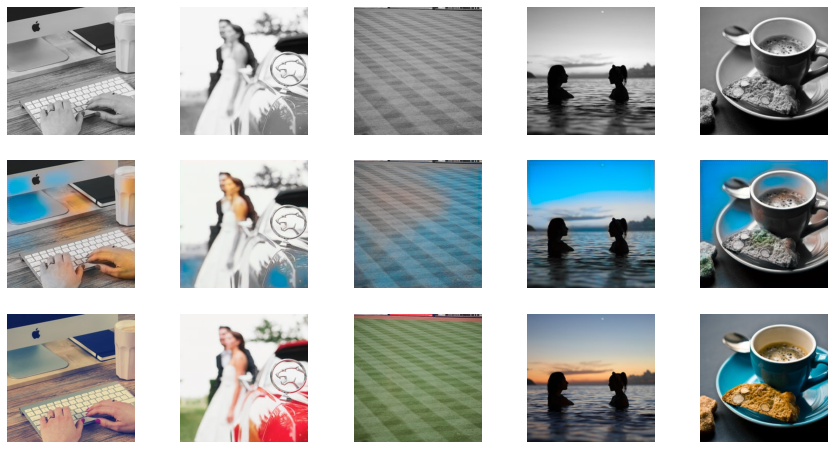


Epoch 1/20
Iteration 400/840
loss_D_fake: 0.70632
loss_D_real: 0.70532
loss_D: 0.70582
loss_G_GAN: 0.71534
loss_G_L1: 0.08585
loss_G: 0.80119


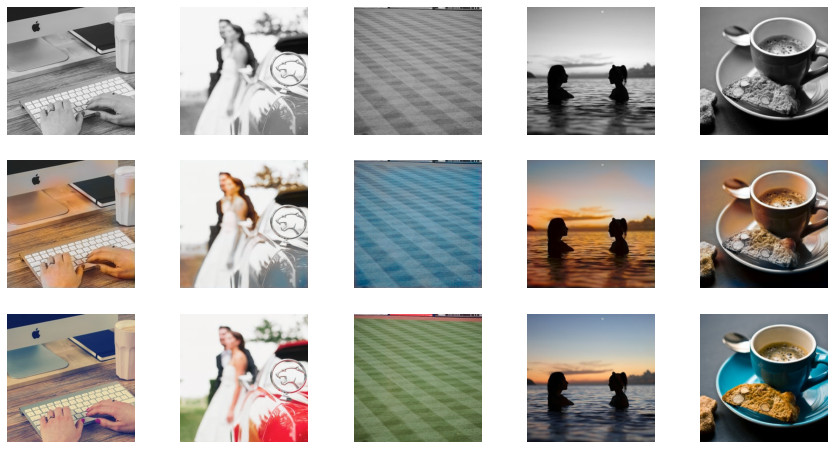


Epoch 1/20
Iteration 600/840
loss_D_fake: 0.70298
loss_D_real: 0.70272
loss_D: 0.70285
loss_G_GAN: 0.71194
loss_G_L1: 0.08586
loss_G: 0.79780


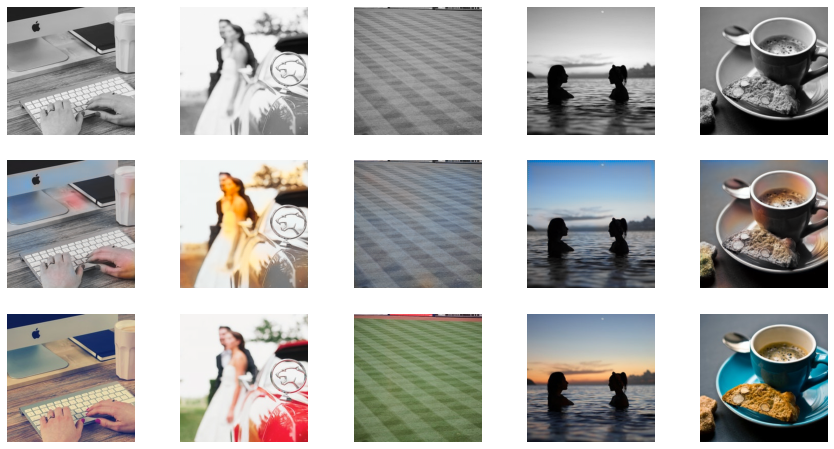


Epoch 1/20
Iteration 800/840
loss_D_fake: 0.70106
loss_D_real: 0.70129
loss_D: 0.70118
loss_G_GAN: 0.71041
loss_G_L1: 0.08626
loss_G: 0.79668


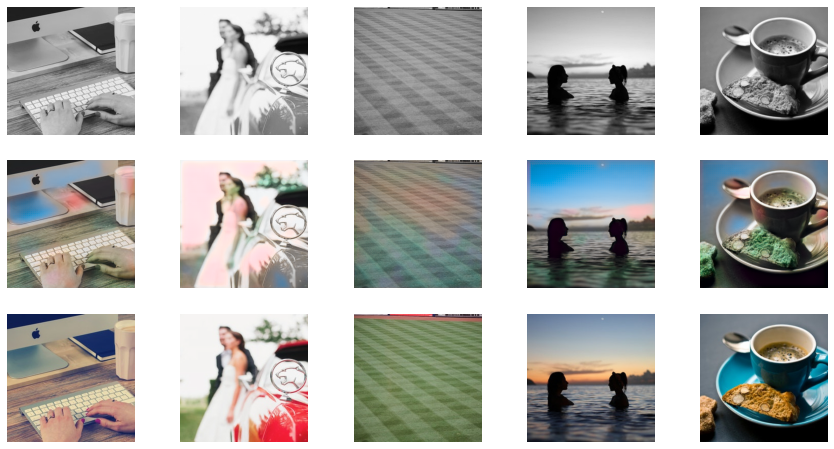


Epoch 2/20
Iteration 200/840
loss_D_fake: 0.69583
loss_D_real: 0.69669
loss_D: 0.69626
loss_G_GAN: 0.70476
loss_G_L1: 0.08561
loss_G: 0.79037


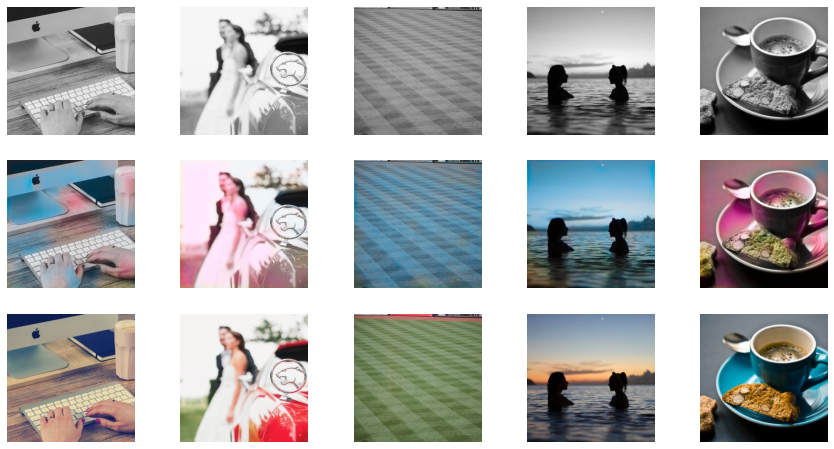


Epoch 2/20
Iteration 400/840
loss_D_fake: 0.69563
loss_D_real: 0.69618
loss_D: 0.69591
loss_G_GAN: 0.70395
loss_G_L1: 0.08668
loss_G: 0.79063


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 46 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


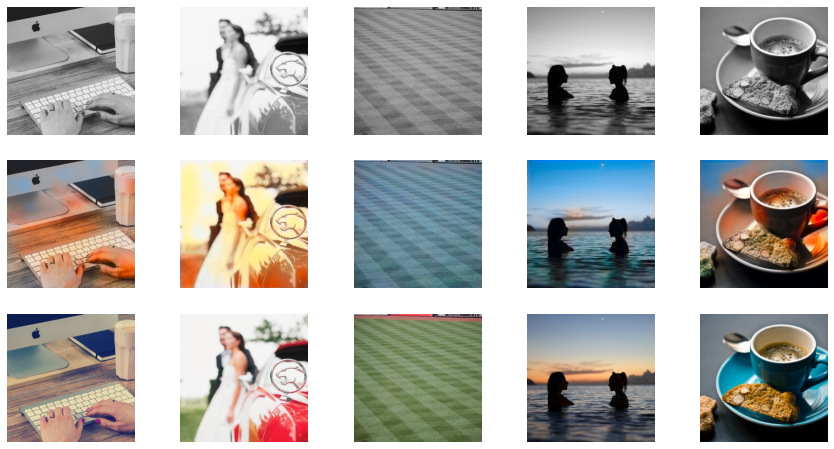


Epoch 2/20
Iteration 600/840
loss_D_fake: 0.69563
loss_D_real: 0.69632
loss_D: 0.69597
loss_G_GAN: 0.70464
loss_G_L1: 0.08645
loss_G: 0.79109


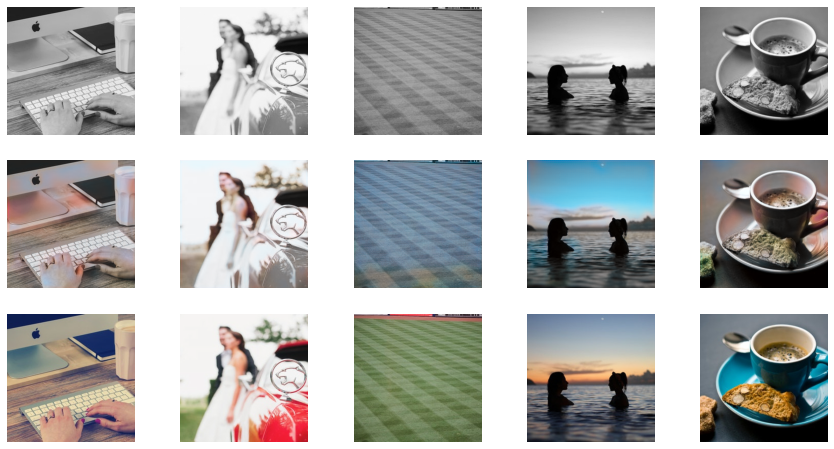


Epoch 2/20
Iteration 800/840
loss_D_fake: 0.69539
loss_D_real: 0.69616
loss_D: 0.69578
loss_G_GAN: 0.70398
loss_G_L1: 0.08652
loss_G: 0.79050


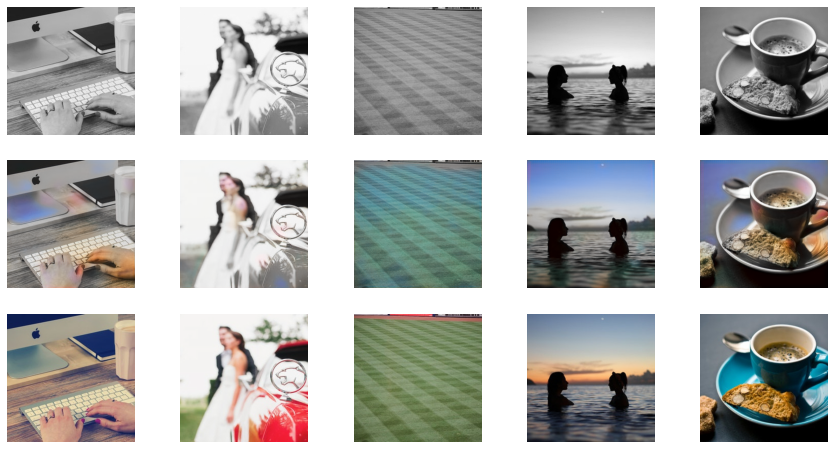


Epoch 3/20
Iteration 200/840
loss_D_fake: 0.69510
loss_D_real: 0.69569
loss_D: 0.69539
loss_G_GAN: 0.70241
loss_G_L1: 0.08496
loss_G: 0.78737


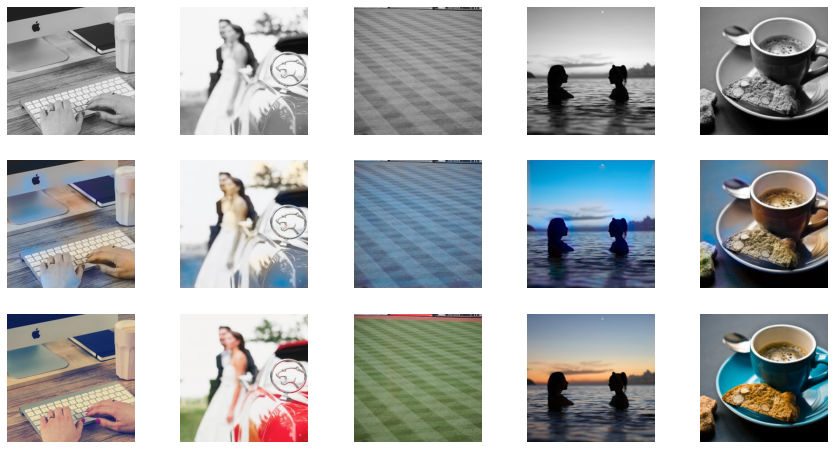


Epoch 3/20
Iteration 400/840
loss_D_fake: 0.69531
loss_D_real: 0.69607
loss_D: 0.69569
loss_G_GAN: 0.70228
loss_G_L1: 0.08650
loss_G: 0.78878


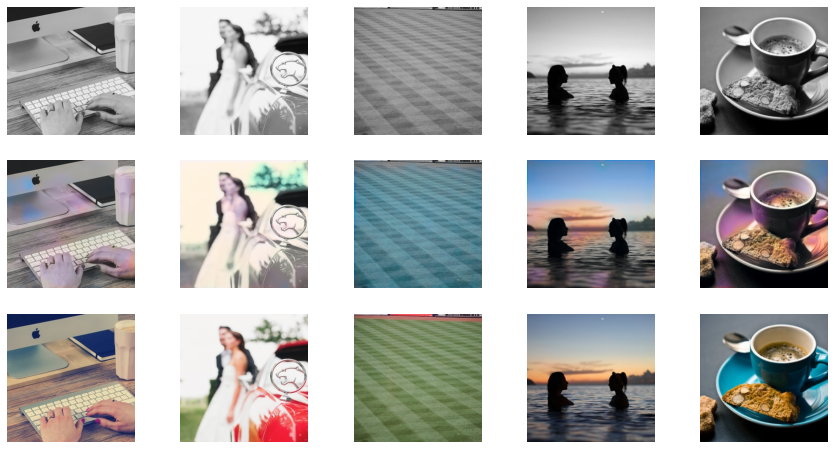


Epoch 3/20
Iteration 600/840
loss_D_fake: 0.69506
loss_D_real: 0.69600
loss_D: 0.69553
loss_G_GAN: 0.70243
loss_G_L1: 0.08613
loss_G: 0.78856


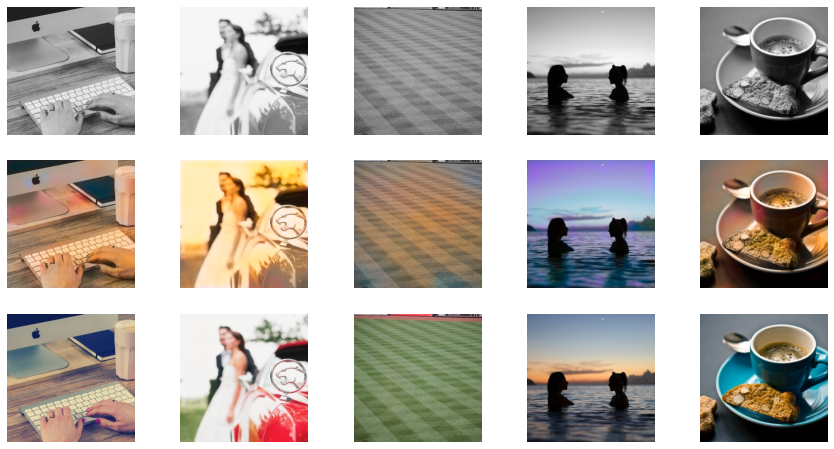


Epoch 3/20
Iteration 800/840
loss_D_fake: 0.69494
loss_D_real: 0.69613
loss_D: 0.69554
loss_G_GAN: 0.70258
loss_G_L1: 0.08608
loss_G: 0.78866


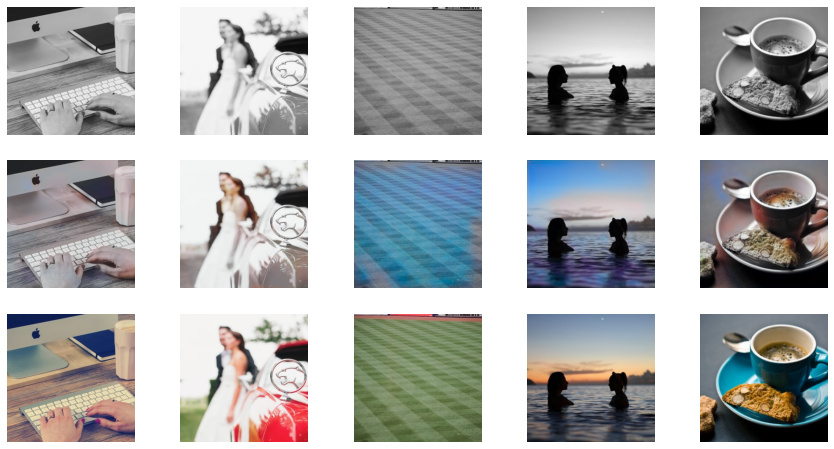


Epoch 4/20
Iteration 200/840
loss_D_fake: 0.69426
loss_D_real: 0.69549
loss_D: 0.69487
loss_G_GAN: 0.70032
loss_G_L1: 0.08355
loss_G: 0.78387


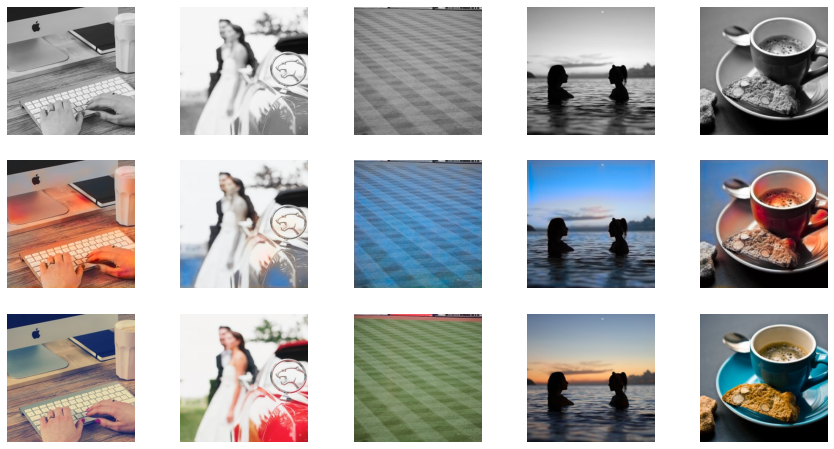


Epoch 4/20
Iteration 400/840
loss_D_fake: 0.69426
loss_D_real: 0.69540
loss_D: 0.69483
loss_G_GAN: 0.70054
loss_G_L1: 0.08439
loss_G: 0.78493


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 103 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


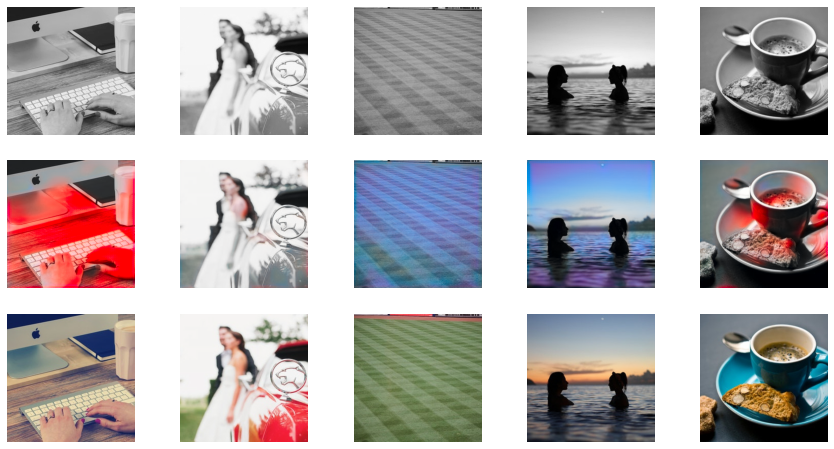


Epoch 4/20
Iteration 600/840
loss_D_fake: 0.69457
loss_D_real: 0.69584
loss_D: 0.69521
loss_G_GAN: 0.70159
loss_G_L1: 0.08462
loss_G: 0.78621


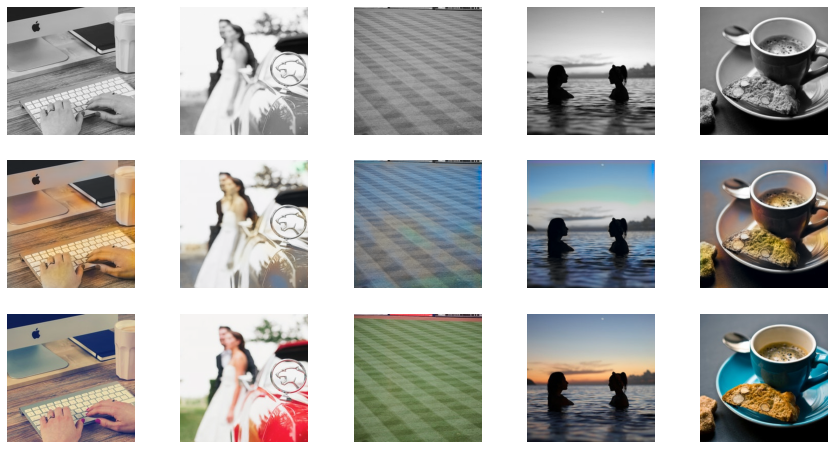


Epoch 4/20
Iteration 800/840
loss_D_fake: 0.69480
loss_D_real: 0.69606
loss_D: 0.69543
loss_G_GAN: 0.70296
loss_G_L1: 0.08566
loss_G: 0.78862


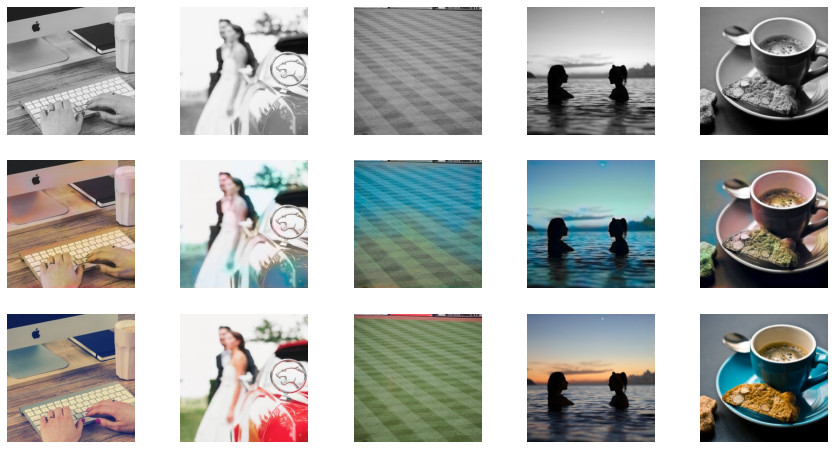


Epoch 5/20
Iteration 200/840
loss_D_fake: 0.69503
loss_D_real: 0.69406
loss_D: 0.69455
loss_G_GAN: 0.70030
loss_G_L1: 0.08367
loss_G: 0.78397


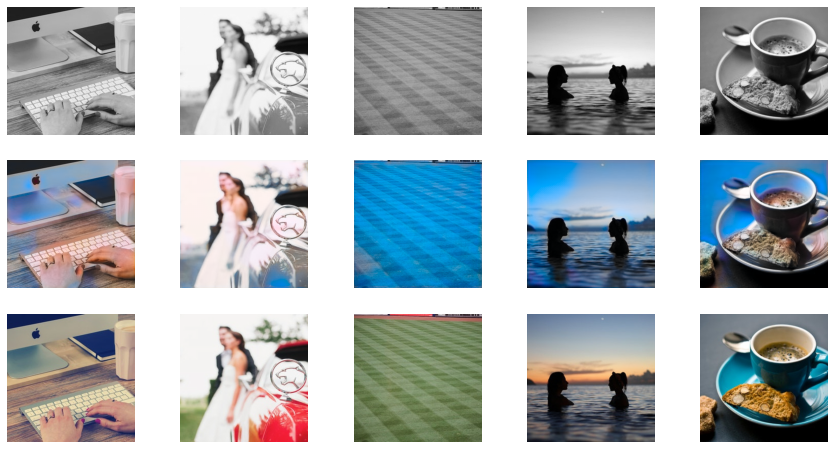


Epoch 5/20
Iteration 400/840
loss_D_fake: 0.69492
loss_D_real: 0.69484
loss_D: 0.69488
loss_G_GAN: 0.70113
loss_G_L1: 0.08610
loss_G: 0.78723


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 61 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


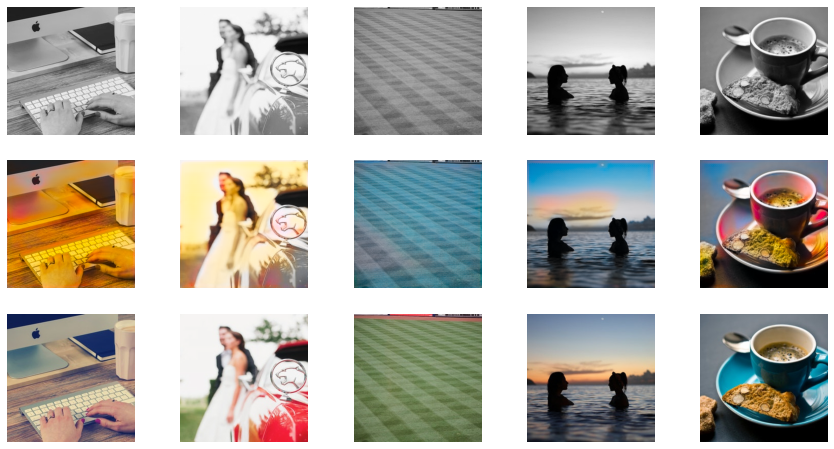


Epoch 5/20
Iteration 600/840
loss_D_fake: 0.69484
loss_D_real: 0.69482
loss_D: 0.69483
loss_G_GAN: 0.70080
loss_G_L1: 0.08574
loss_G: 0.78654


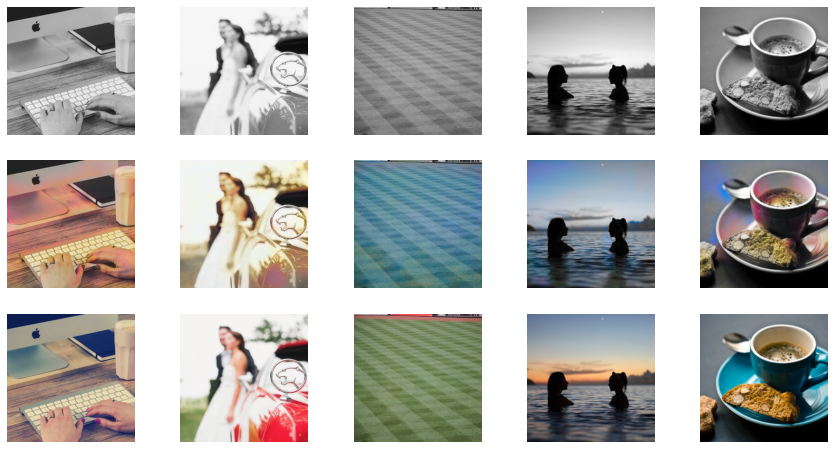


Epoch 5/20
Iteration 800/840
loss_D_fake: 0.69484
loss_D_real: 0.69454
loss_D: 0.69469
loss_G_GAN: 0.70008
loss_G_L1: 0.08493
loss_G: 0.78502


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


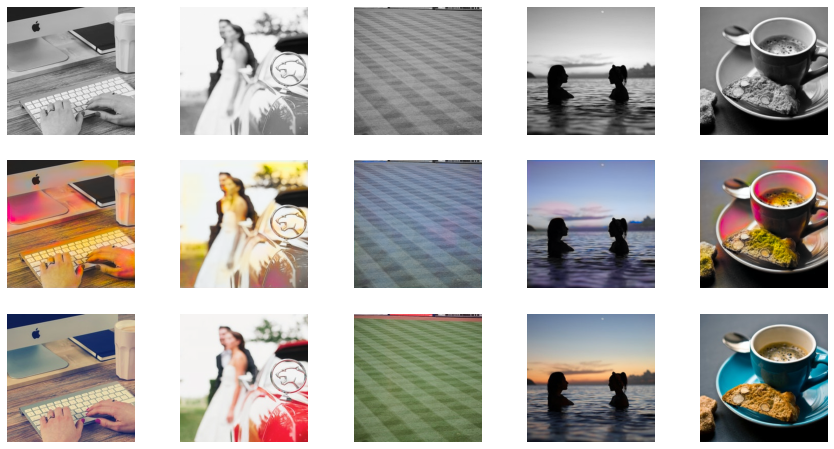


Epoch 6/20
Iteration 200/840
loss_D_fake: 0.69423
loss_D_real: 0.69419
loss_D: 0.69421
loss_G_GAN: 0.69912
loss_G_L1: 0.08319
loss_G: 0.78231


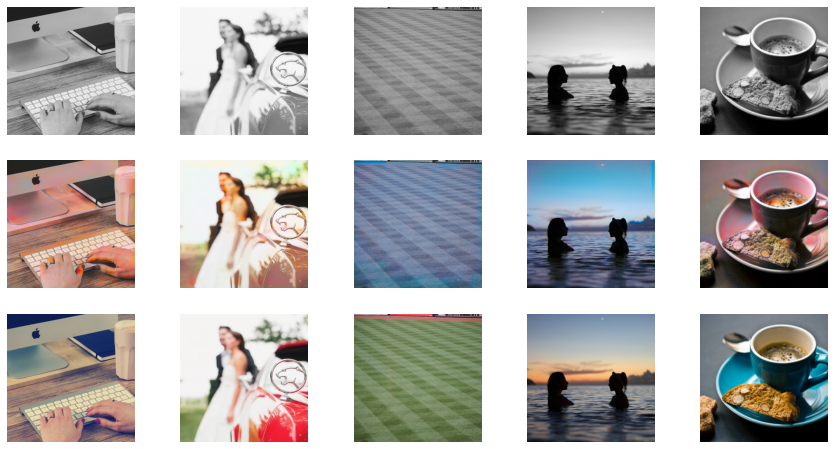


Epoch 6/20
Iteration 400/840
loss_D_fake: 0.69433
loss_D_real: 0.69436
loss_D: 0.69435
loss_G_GAN: 0.69947
loss_G_L1: 0.08256
loss_G: 0.78204


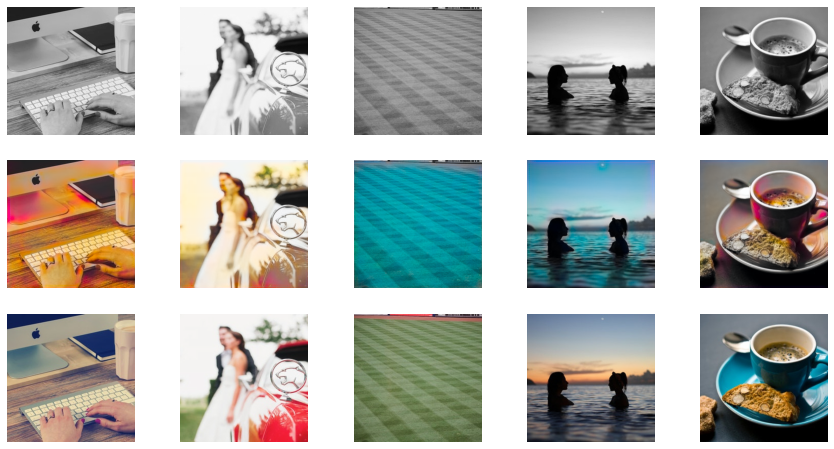


Epoch 6/20
Iteration 600/840
loss_D_fake: 0.69463
loss_D_real: 0.69435
loss_D: 0.69449
loss_G_GAN: 0.69928
loss_G_L1: 0.08369
loss_G: 0.78297


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 42 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 24 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


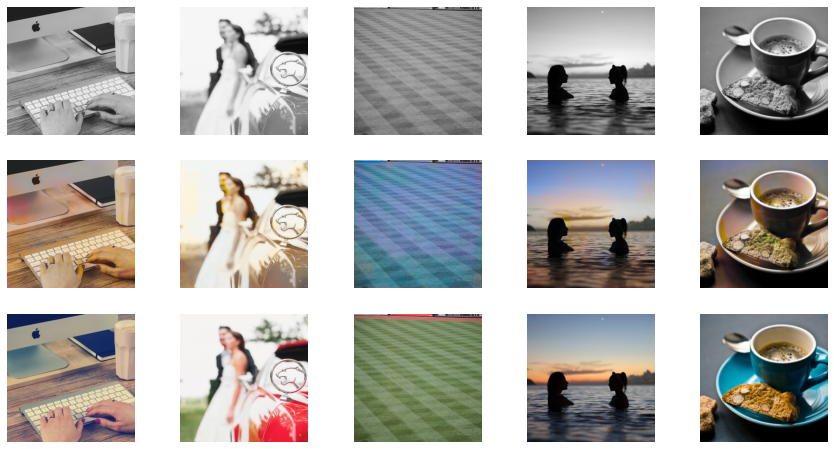


Epoch 6/20
Iteration 800/840
loss_D_fake: 0.69478
loss_D_real: 0.69472
loss_D: 0.69475
loss_G_GAN: 0.70001
loss_G_L1: 0.08408
loss_G: 0.78409


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 52 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 34 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 19 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


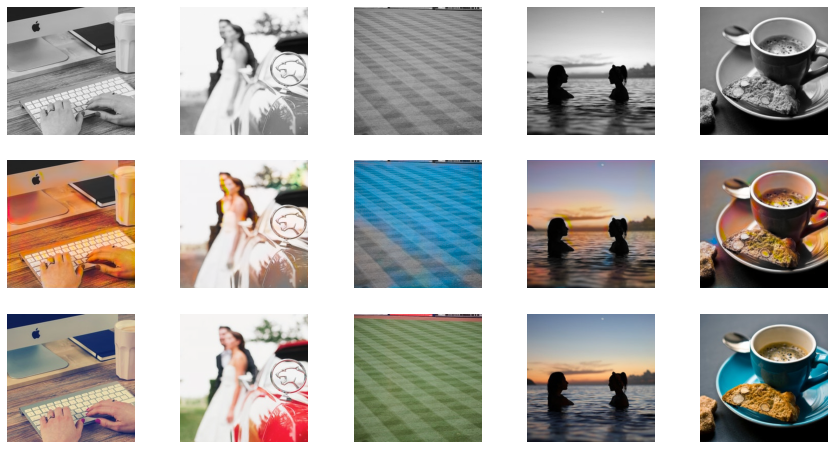


Epoch 7/20
Iteration 200/840
loss_D_fake: 0.69480
loss_D_real: 0.69419
loss_D: 0.69450
loss_G_GAN: 0.69909
loss_G_L1: 0.08302
loss_G: 0.78211


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


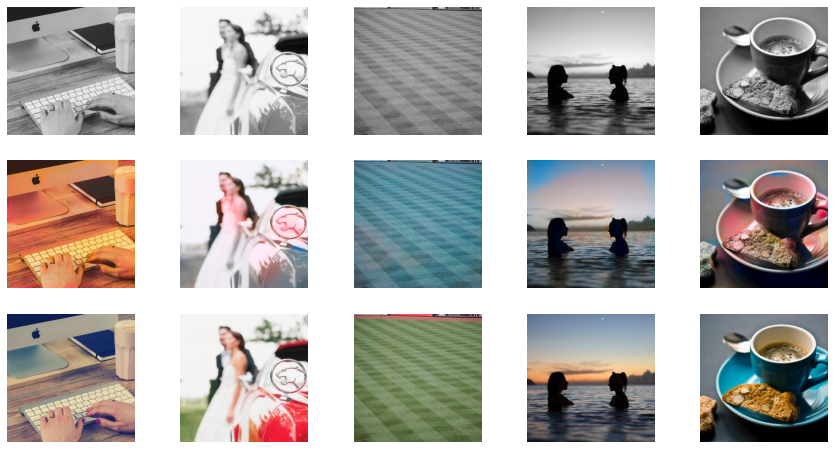


Epoch 7/20
Iteration 400/840
loss_D_fake: 0.69465
loss_D_real: 0.69430
loss_D: 0.69448
loss_G_GAN: 0.69884
loss_G_L1: 0.08169
loss_G: 0.78052


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 177 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 123 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


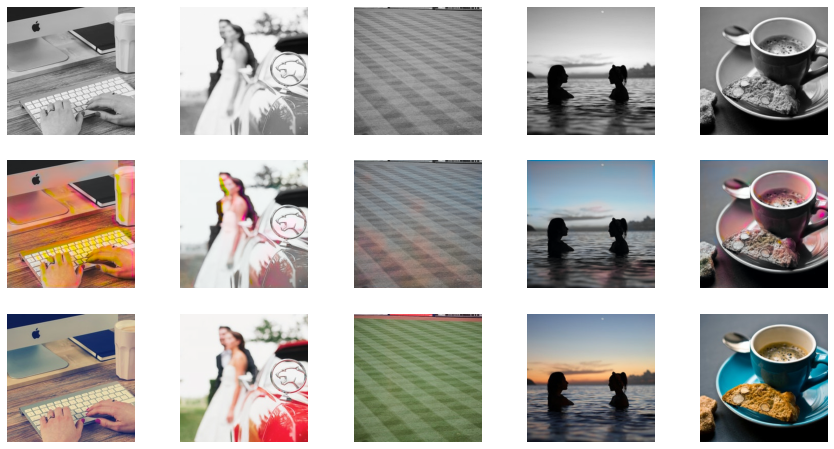


Epoch 7/20
Iteration 600/840
loss_D_fake: 0.69459
loss_D_real: 0.69454
loss_D: 0.69457
loss_G_GAN: 0.69932
loss_G_L1: 0.08256
loss_G: 0.78188


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 30 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 16 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 231 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


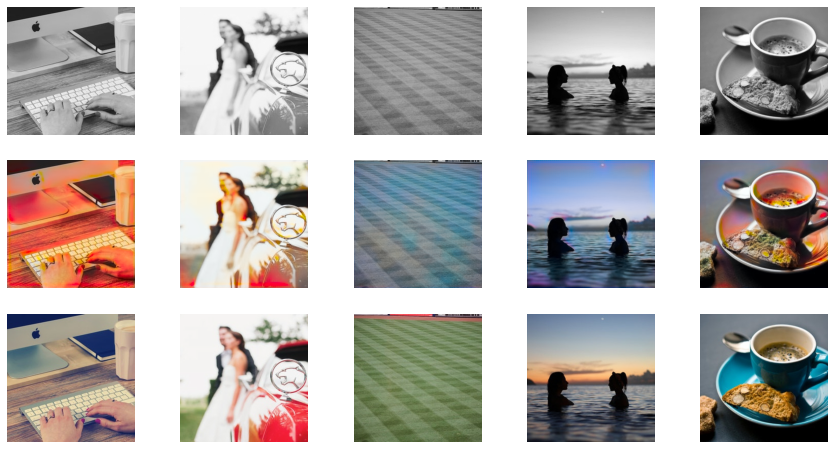


Epoch 7/20
Iteration 800/840
loss_D_fake: 0.69502
loss_D_real: 0.69536
loss_D: 0.69519
loss_G_GAN: 0.70048
loss_G_L1: 0.08105
loss_G: 0.78153


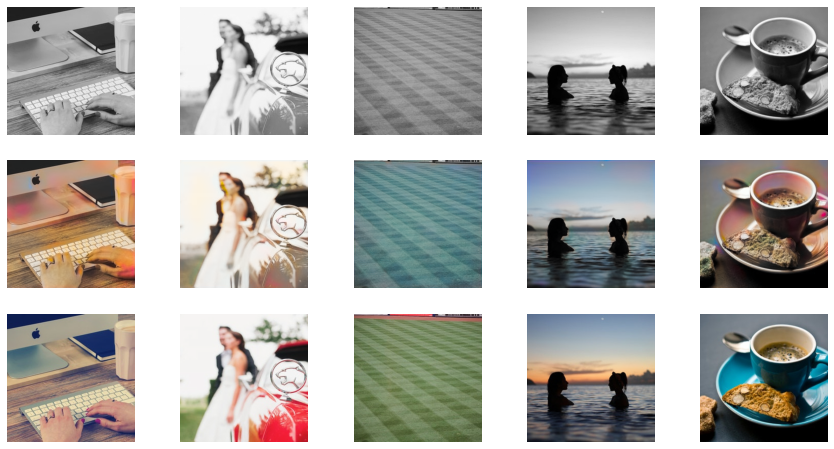


Epoch 8/20
Iteration 200/840
loss_D_fake: 0.69492
loss_D_real: 0.69578
loss_D: 0.69535
loss_G_GAN: 0.70276
loss_G_L1: 0.07870
loss_G: 0.78146


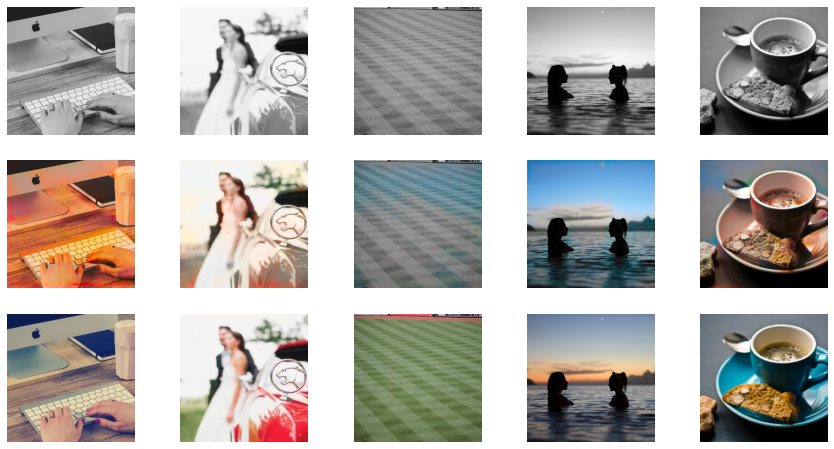


Epoch 8/20
Iteration 400/840
loss_D_fake: 0.69452
loss_D_real: 0.69492
loss_D: 0.69472
loss_G_GAN: 0.70151
loss_G_L1: 0.07931
loss_G: 0.78082


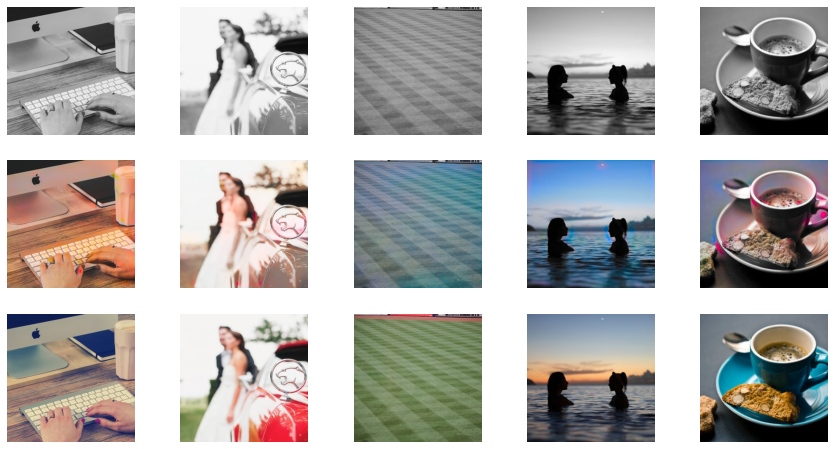


Epoch 8/20
Iteration 600/840
loss_D_fake: 0.69446
loss_D_real: 0.69483
loss_D: 0.69464
loss_G_GAN: 0.70093
loss_G_L1: 0.08013
loss_G: 0.78105


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


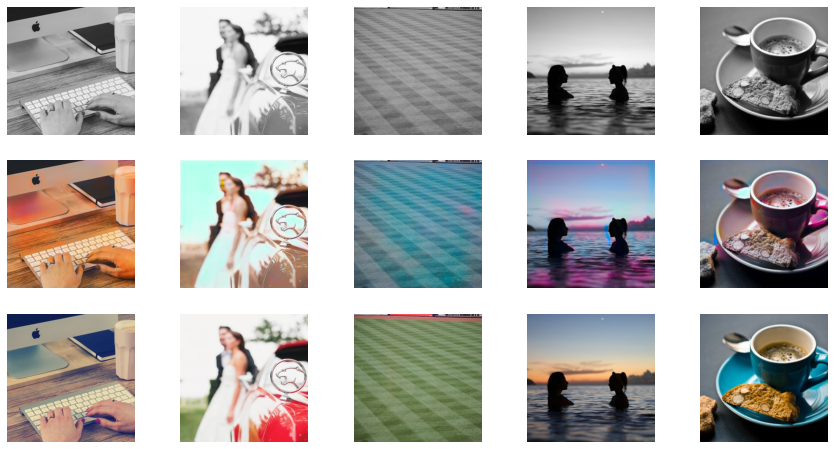


Epoch 8/20
Iteration 800/840
loss_D_fake: 0.69487
loss_D_real: 0.69513
loss_D: 0.69500
loss_G_GAN: 0.70178
loss_G_L1: 0.07960
loss_G: 0.78138


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 21 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


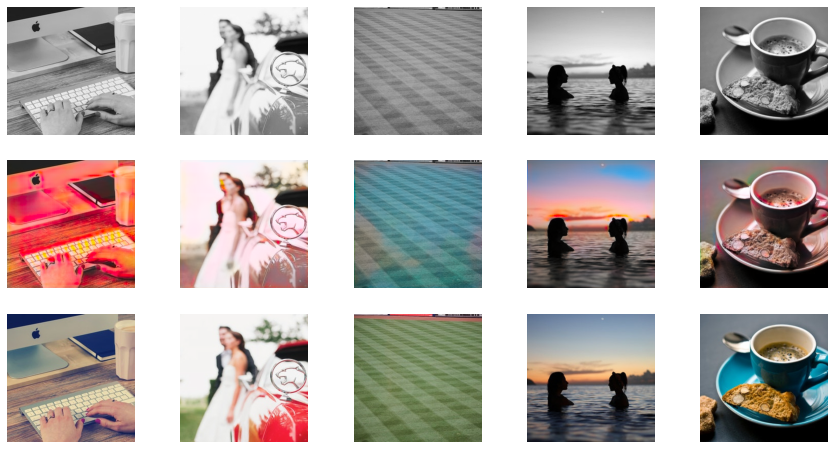


Epoch 9/20
Iteration 200/840
loss_D_fake: 0.69483
loss_D_real: 0.69476
loss_D: 0.69479
loss_G_GAN: 0.70126
loss_G_L1: 0.07872
loss_G: 0.77998


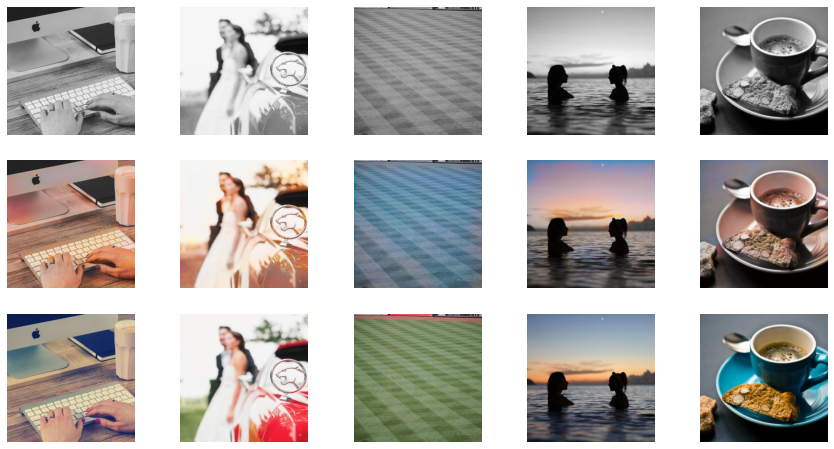


Epoch 9/20
Iteration 400/840
loss_D_fake: 0.69464
loss_D_real: 0.69453
loss_D: 0.69459
loss_G_GAN: 0.70031
loss_G_L1: 0.07824
loss_G: 0.77854


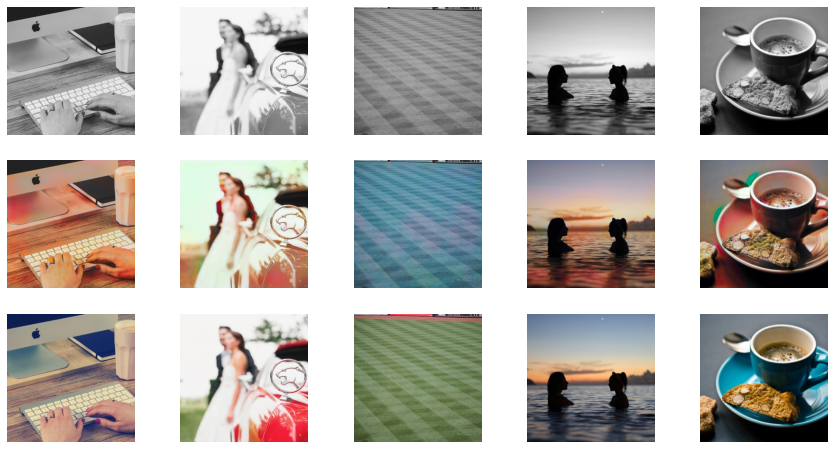


Epoch 9/20
Iteration 600/840
loss_D_fake: 0.69438
loss_D_real: 0.69444
loss_D: 0.69441
loss_G_GAN: 0.70023
loss_G_L1: 0.07858
loss_G: 0.77881


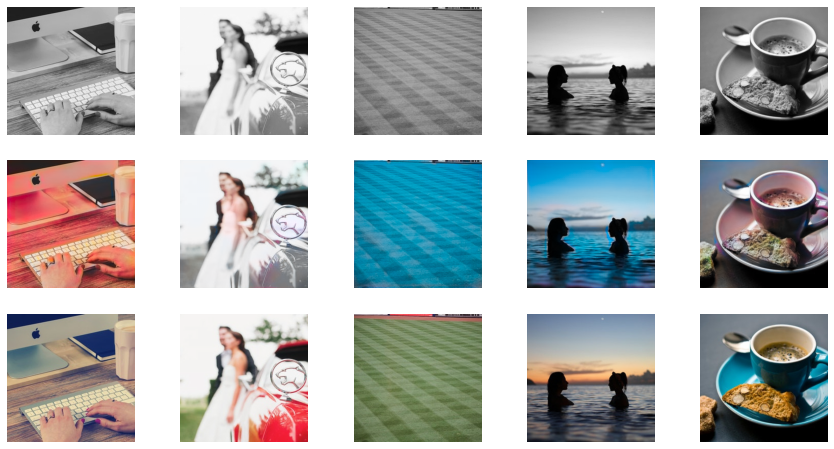


Epoch 9/20
Iteration 800/840
loss_D_fake: 0.69409
loss_D_real: 0.69454
loss_D: 0.69431
loss_G_GAN: 0.69995
loss_G_L1: 0.07849
loss_G: 0.77843


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


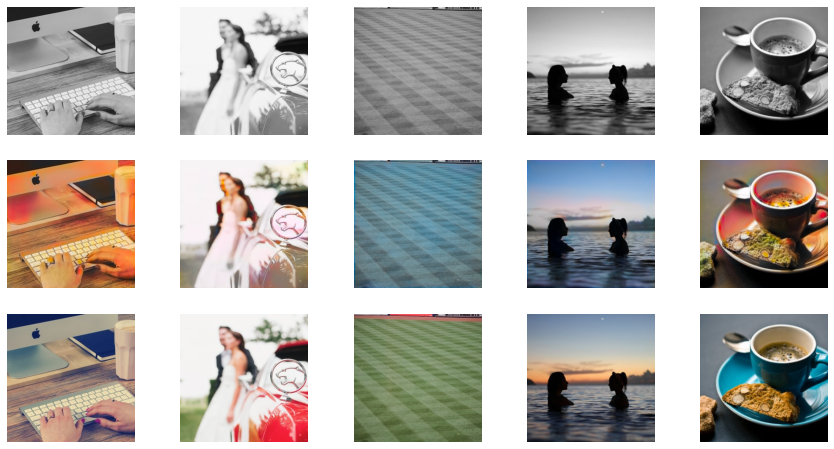


Epoch 10/20
Iteration 200/840
loss_D_fake: 0.69418
loss_D_real: 0.69375
loss_D: 0.69397
loss_G_GAN: 0.69825
loss_G_L1: 0.07609
loss_G: 0.77434


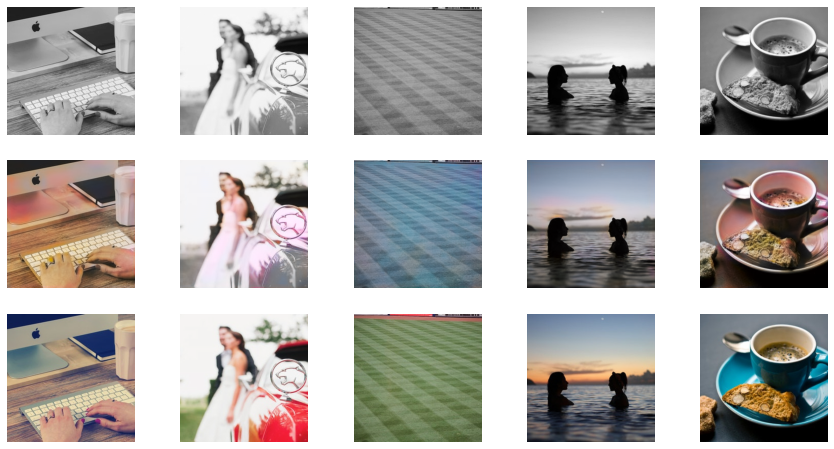


Epoch 10/20
Iteration 400/840
loss_D_fake: 0.69400
loss_D_real: 0.69421
loss_D: 0.69410
loss_G_GAN: 0.69856
loss_G_L1: 0.07641
loss_G: 0.77497


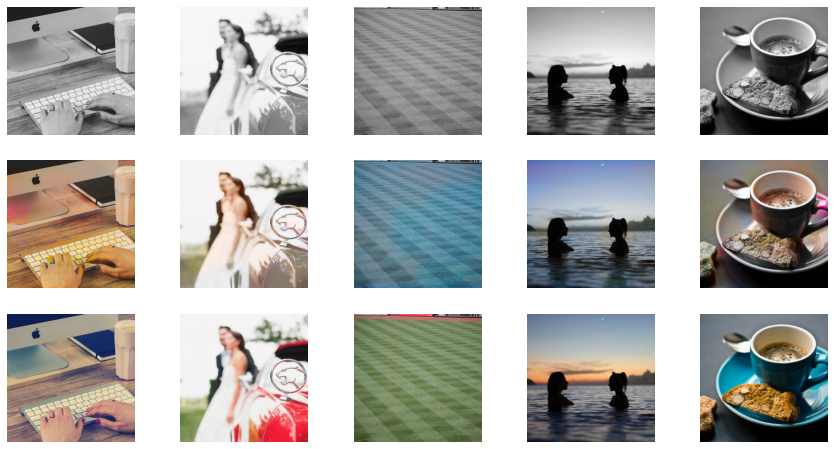


Epoch 10/20
Iteration 600/840
loss_D_fake: 0.69459
loss_D_real: 0.69450
loss_D: 0.69455
loss_G_GAN: 0.69998
loss_G_L1: 0.07727
loss_G: 0.77725


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 23 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


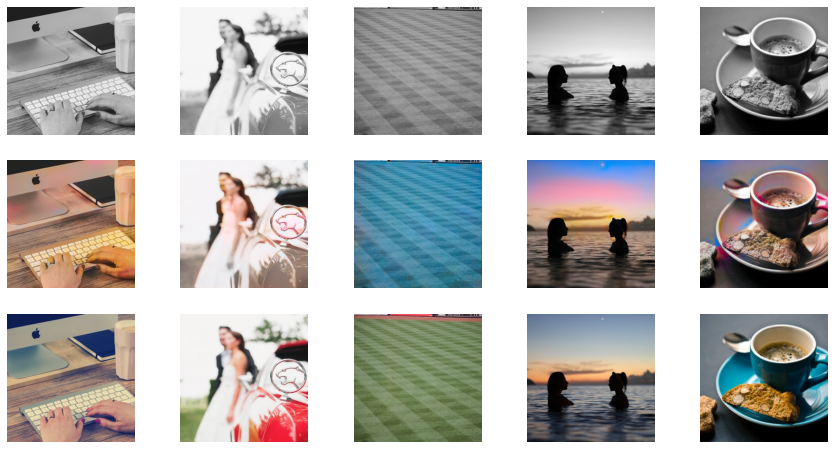


Epoch 10/20
Iteration 800/840
loss_D_fake: 0.69521
loss_D_real: 0.69529
loss_D: 0.69525
loss_G_GAN: 0.70318
loss_G_L1: 0.07848
loss_G: 0.78167


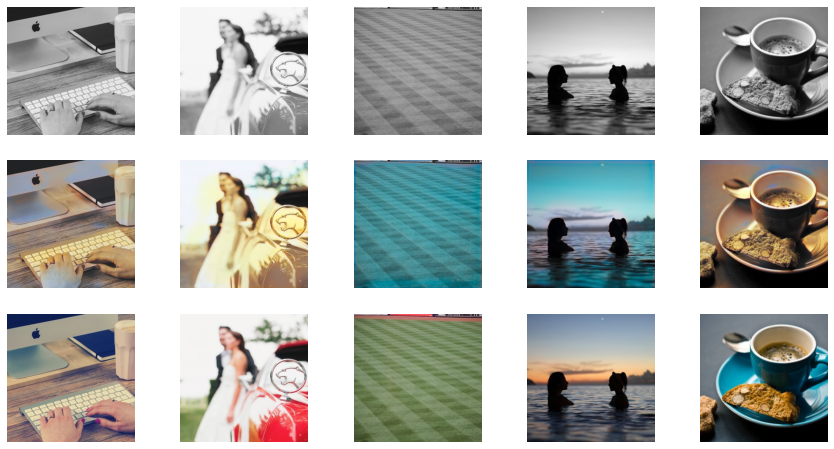


Epoch 11/20
Iteration 200/840
loss_D_fake: 0.69962
loss_D_real: 0.69530
loss_D: 0.69746
loss_G_GAN: 0.72687
loss_G_L1: 0.09789
loss_G: 0.82476


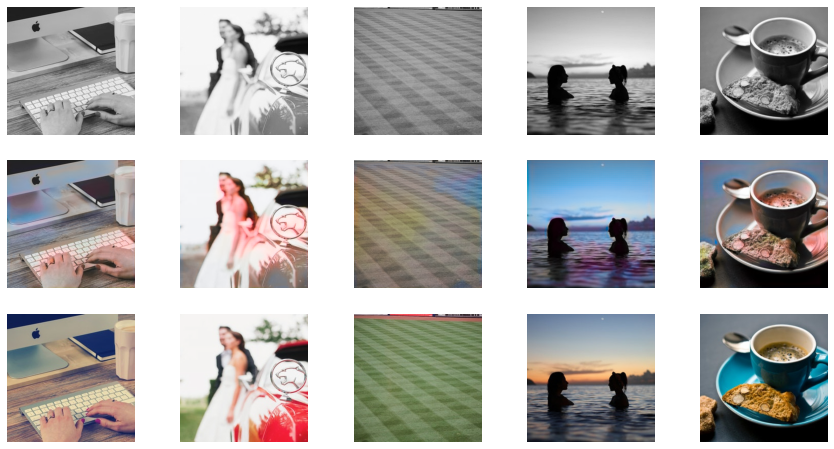


Epoch 11/20
Iteration 400/840
loss_D_fake: 0.70079
loss_D_real: 0.69082
loss_D: 0.69580
loss_G_GAN: 0.73350
loss_G_L1: 0.10329
loss_G: 0.83679


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4605 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5629 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5054 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of

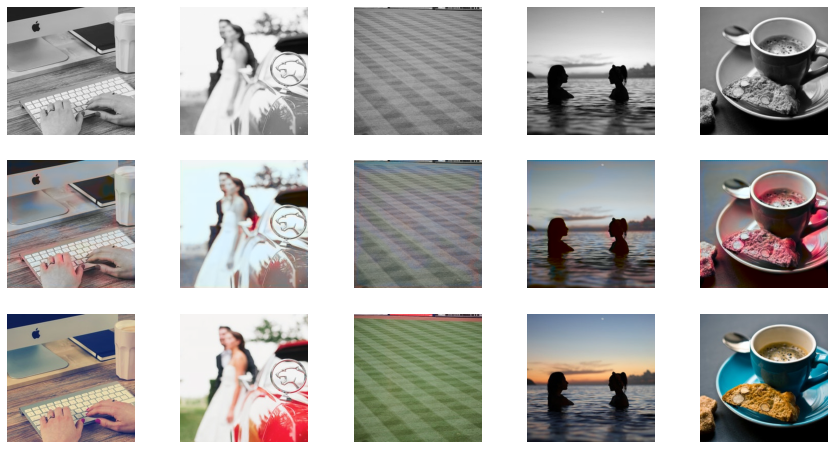


Epoch 11/20
Iteration 600/840
loss_D_fake: 0.70042
loss_D_real: 0.69275
loss_D: 0.69658
loss_G_GAN: 0.73287
loss_G_L1: 0.10381
loss_G: 0.83668


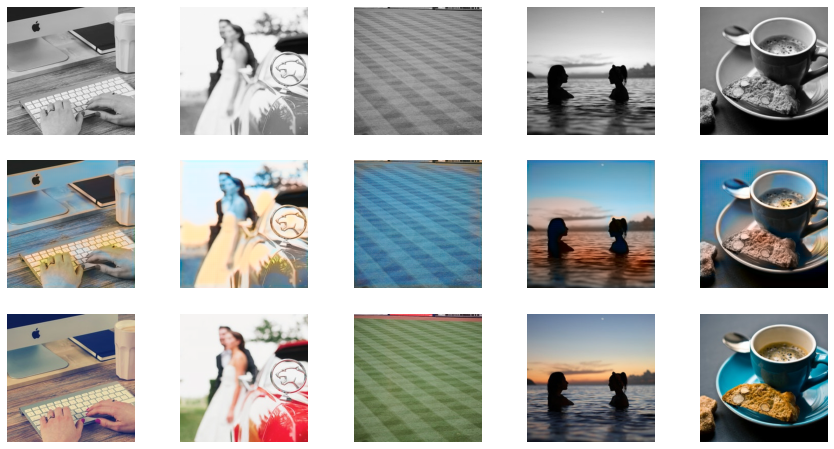


Epoch 11/20
Iteration 800/840
loss_D_fake: 0.69906
loss_D_real: 0.69285
loss_D: 0.69596
loss_G_GAN: 0.72969
loss_G_L1: 0.10320
loss_G: 0.83289


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 134 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


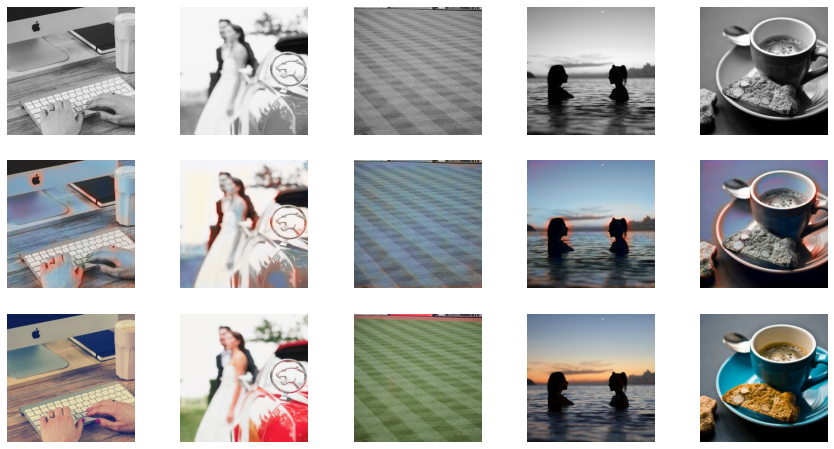


Epoch 12/20
Iteration 200/840
loss_D_fake: 0.69545
loss_D_real: 0.69255
loss_D: 0.69400
loss_G_GAN: 0.72421
loss_G_L1: 0.10375
loss_G: 0.82795


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1046 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2886 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 71 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5312 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out o

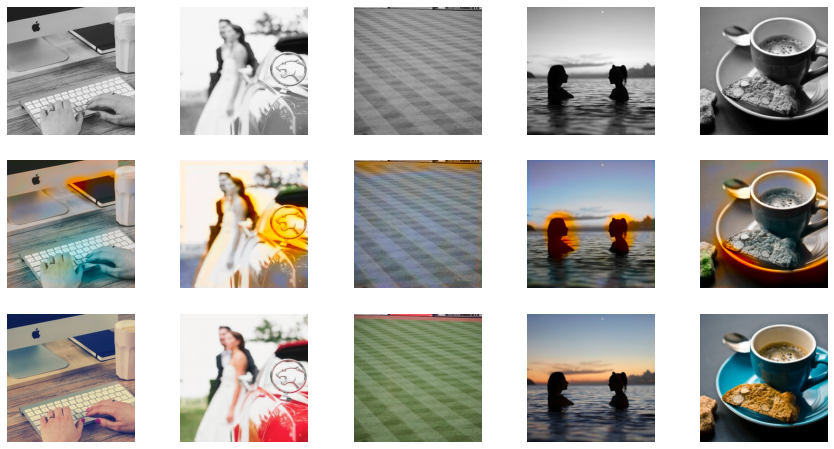


Epoch 12/20
Iteration 400/840
loss_D_fake: 0.69749
loss_D_real: 0.69097
loss_D: 0.69423
loss_G_GAN: 0.72669
loss_G_L1: 0.10364
loss_G: 0.83033


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 590 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2057 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


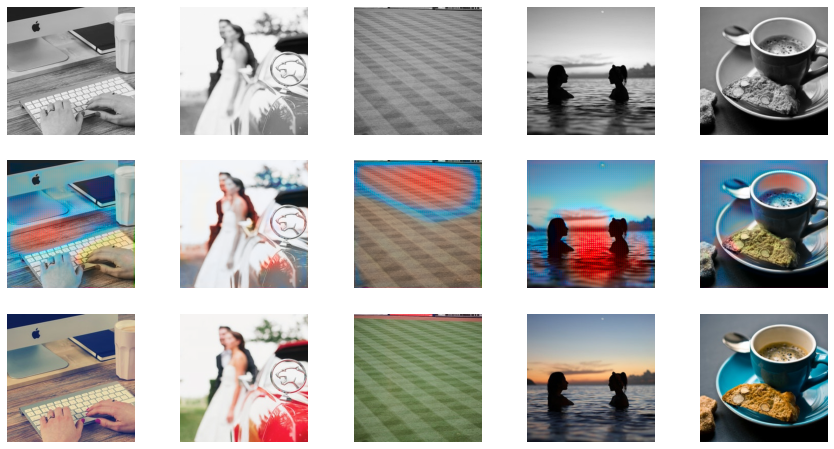


Epoch 12/20
Iteration 600/840
loss_D_fake: 0.69655
loss_D_real: 0.69249
loss_D: 0.69452
loss_G_GAN: 0.72430
loss_G_L1: 0.10332
loss_G: 0.82762


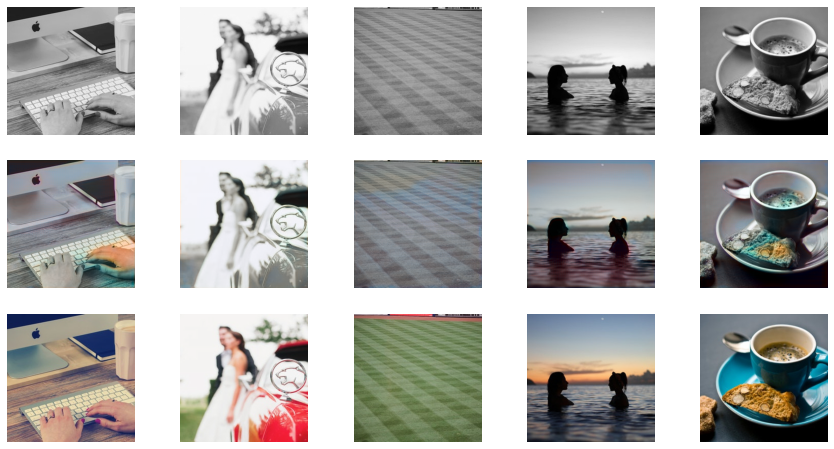


Epoch 12/20
Iteration 800/840
loss_D_fake: 0.69574
loss_D_real: 0.69264
loss_D: 0.69419
loss_G_GAN: 0.72543
loss_G_L1: 0.10520
loss_G: 0.83063


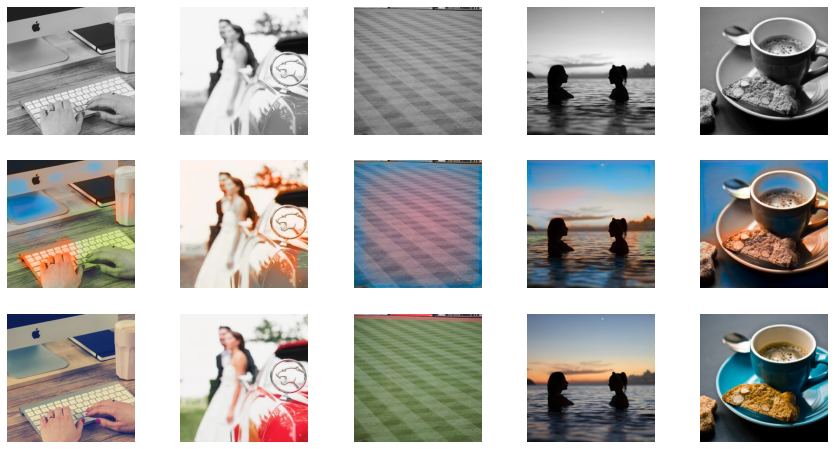


Epoch 13/20
Iteration 200/840
loss_D_fake: 0.69653
loss_D_real: 0.69572
loss_D: 0.69613
loss_G_GAN: 0.72644
loss_G_L1: 0.10807
loss_G: 0.83451


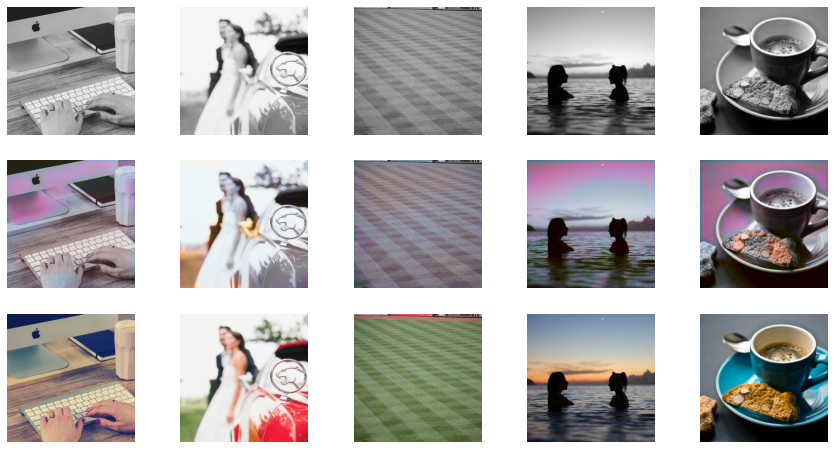


Epoch 13/20
Iteration 400/840
loss_D_fake: 0.69348
loss_D_real: 0.69809
loss_D: 0.69578
loss_G_GAN: 0.72273
loss_G_L1: 0.10694
loss_G: 0.82967


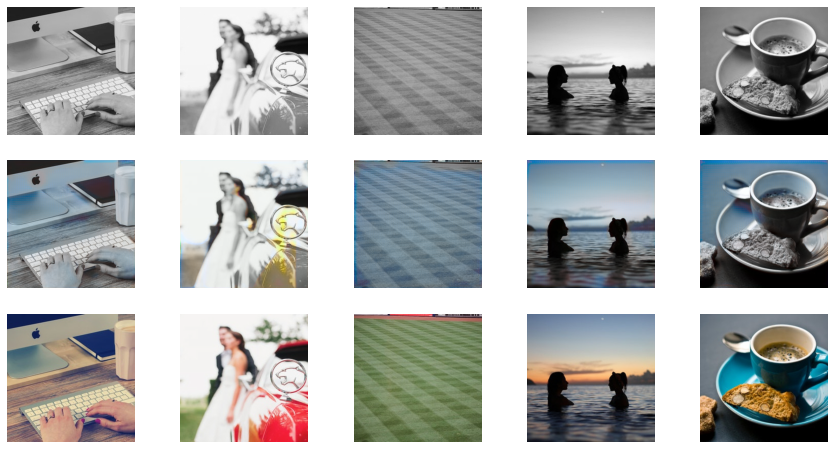


Epoch 13/20
Iteration 600/840
loss_D_fake: 0.69530
loss_D_real: 0.69333
loss_D: 0.69431
loss_G_GAN: 0.72312
loss_G_L1: 0.10798
loss_G: 0.83110


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3047 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


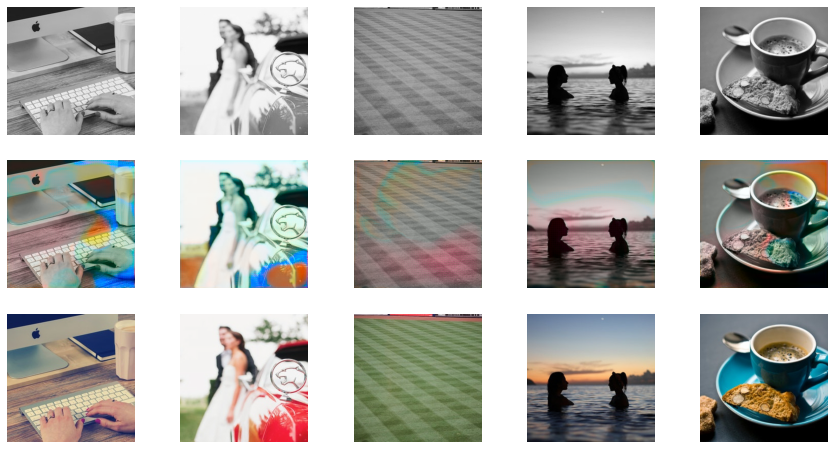


Epoch 13/20
Iteration 800/840
loss_D_fake: 0.69631
loss_D_real: 0.69166
loss_D: 0.69398
loss_G_GAN: 0.72148
loss_G_L1: 0.10797
loss_G: 0.82945


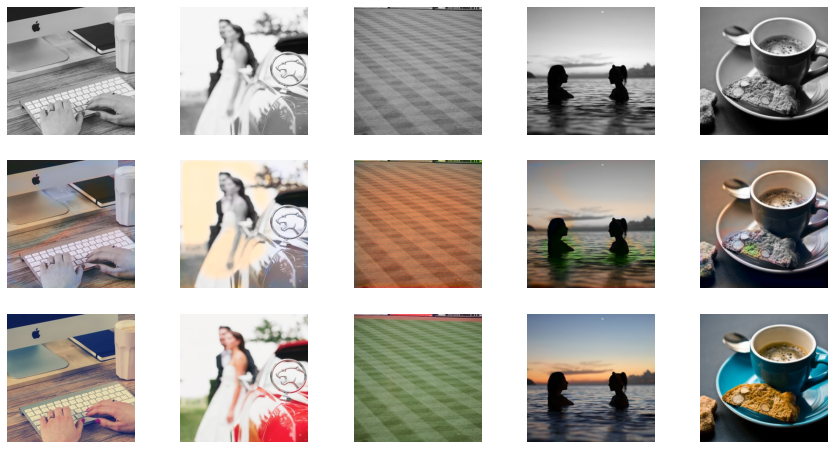


Epoch 14/20
Iteration 200/840
loss_D_fake: 0.69248
loss_D_real: 0.68515
loss_D: 0.68881
loss_G_GAN: 0.73897
loss_G_L1: 0.11034
loss_G: 0.84932


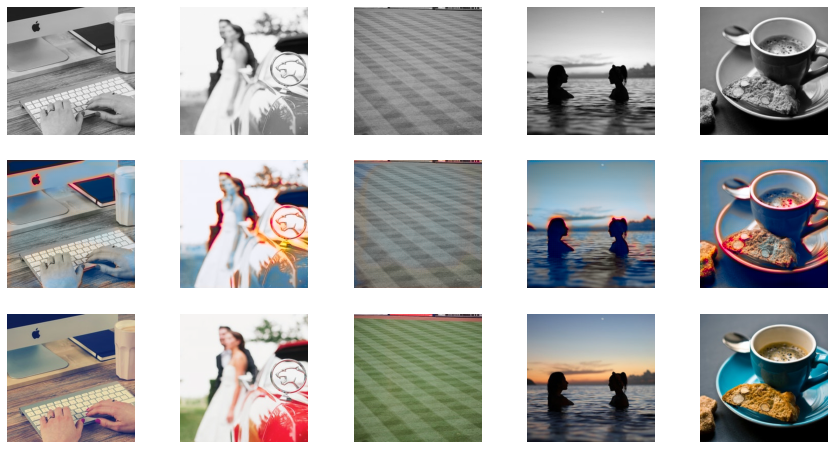


Epoch 14/20
Iteration 400/840
loss_D_fake: 0.69224
loss_D_real: 0.69168
loss_D: 0.69196
loss_G_GAN: 0.73492
loss_G_L1: 0.10981
loss_G: 0.84473


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 38487 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1366 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 30439 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


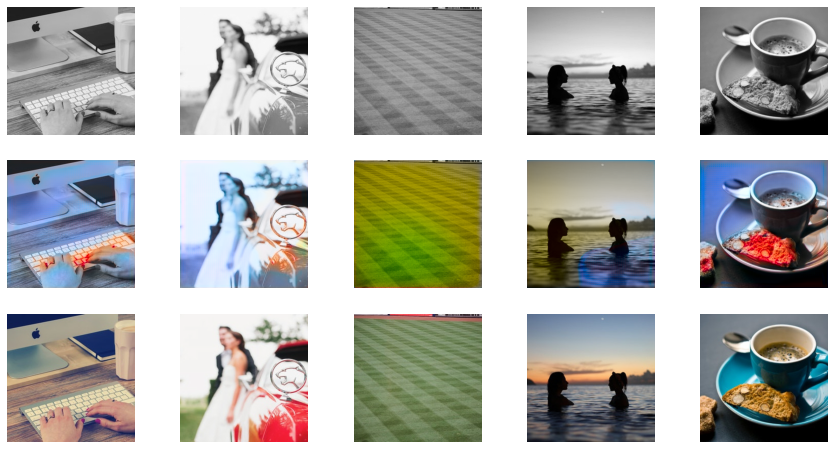


Epoch 14/20
Iteration 600/840
loss_D_fake: 0.69313
loss_D_real: 0.69024
loss_D: 0.69168
loss_G_GAN: 0.73191
loss_G_L1: 0.11049
loss_G: 0.84240


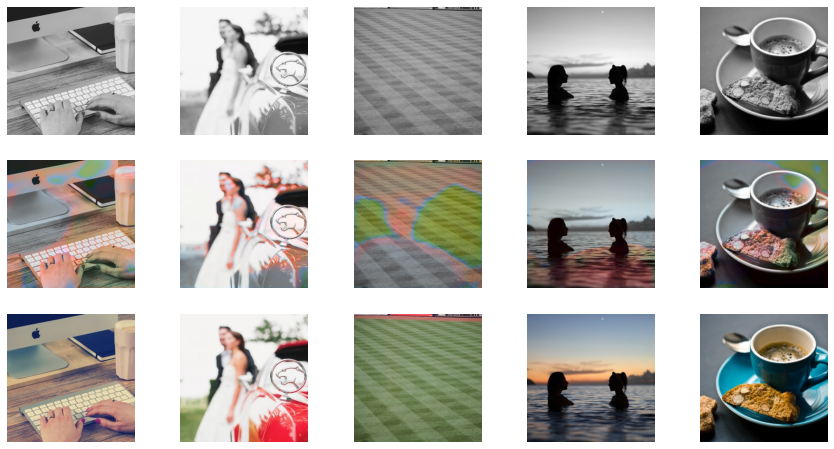


Epoch 14/20
Iteration 800/840
loss_D_fake: 0.69235
loss_D_real: 0.69161
loss_D: 0.69198
loss_G_GAN: 0.73016
loss_G_L1: 0.10959
loss_G: 0.83975


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


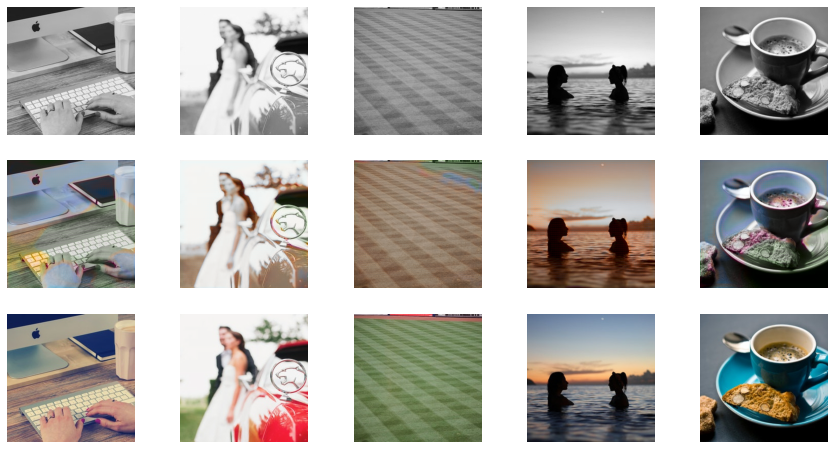


Epoch 15/20
Iteration 200/840
loss_D_fake: 0.69240
loss_D_real: 0.67823
loss_D: 0.68531
loss_G_GAN: 0.73348
loss_G_L1: 0.11036
loss_G: 0.84384


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 145 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


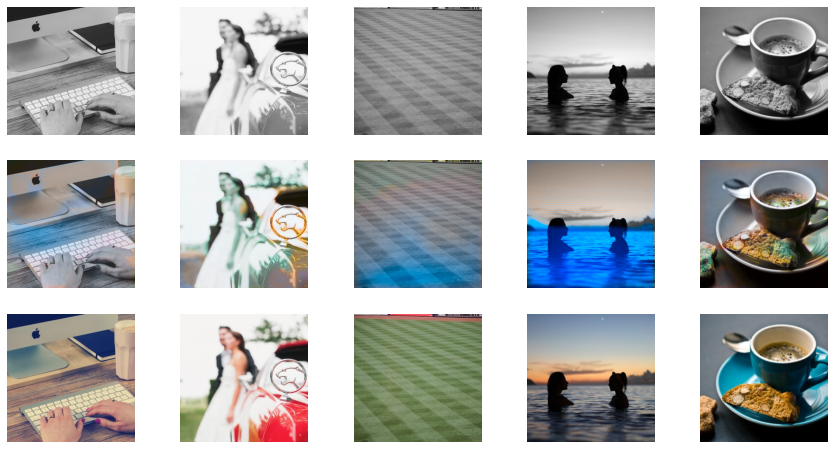


Epoch 15/20
Iteration 400/840
loss_D_fake: 0.69143
loss_D_real: 0.68741
loss_D: 0.68942
loss_G_GAN: 0.73078
loss_G_L1: 0.11083
loss_G: 0.84161


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4766 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


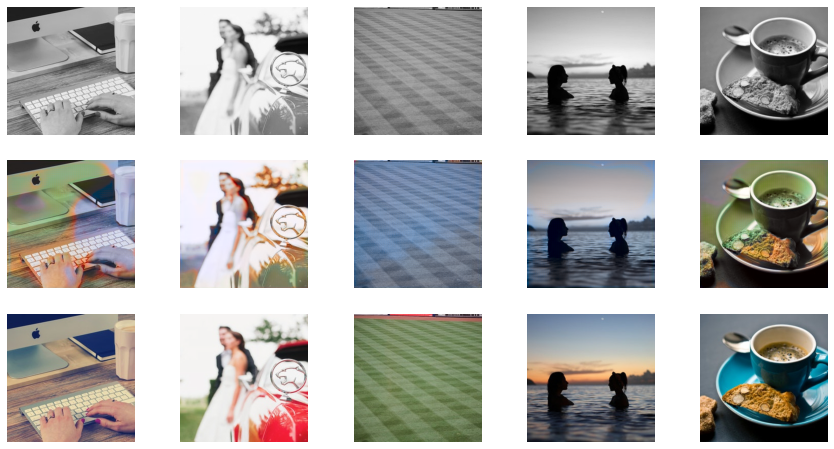


Epoch 15/20
Iteration 600/840
loss_D_fake: 0.69145
loss_D_real: 0.68940
loss_D: 0.69043
loss_G_GAN: 0.72843
loss_G_L1: 0.10940
loss_G: 0.83783


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 49 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


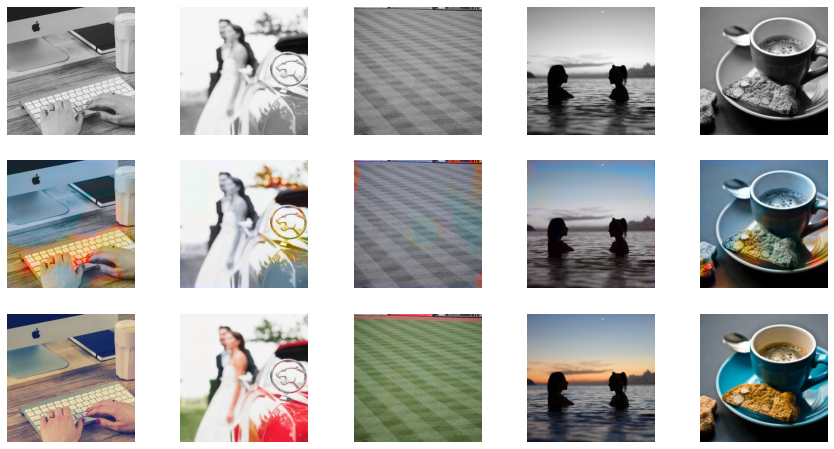


Epoch 15/20
Iteration 800/840
loss_D_fake: 0.69157
loss_D_real: 0.68753
loss_D: 0.68955
loss_G_GAN: 0.73408
loss_G_L1: 0.11136
loss_G: 0.84544


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


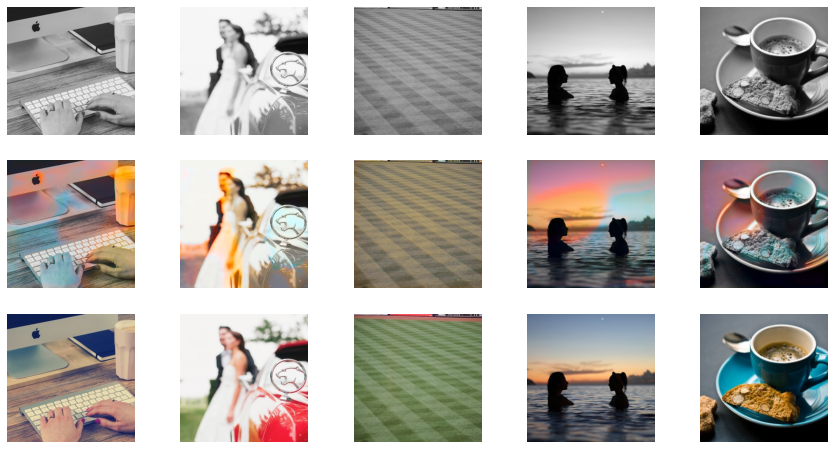


Epoch 16/20
Iteration 200/840
loss_D_fake: 0.69181
loss_D_real: 0.68735
loss_D: 0.68958
loss_G_GAN: 0.72890
loss_G_L1: 0.11145
loss_G: 0.84035


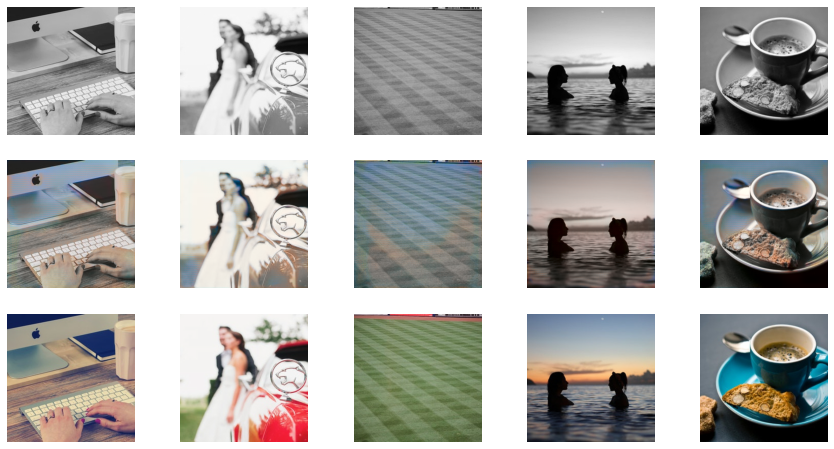


Epoch 16/20
Iteration 400/840
loss_D_fake: 0.69026
loss_D_real: 0.68902
loss_D: 0.68964
loss_G_GAN: 0.73483
loss_G_L1: 0.11388
loss_G: 0.84871


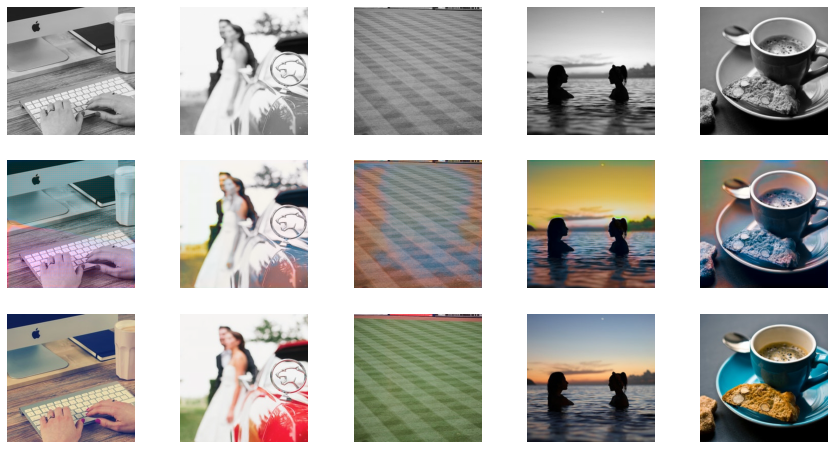


Epoch 16/20
Iteration 600/840
loss_D_fake: 0.69016
loss_D_real: 0.69290
loss_D: 0.69153
loss_G_GAN: 0.73226
loss_G_L1: 0.11289
loss_G: 0.84516


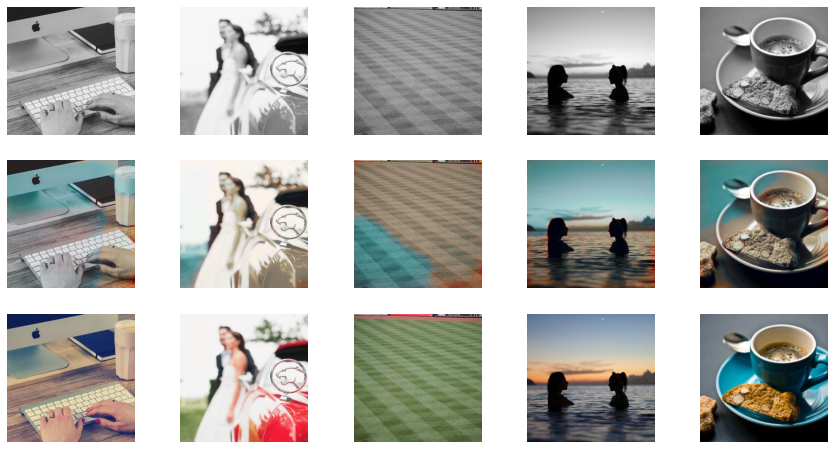


Epoch 16/20
Iteration 800/840
loss_D_fake: 0.69048
loss_D_real: 0.69288
loss_D: 0.69168
loss_G_GAN: 0.73032
loss_G_L1: 0.11153
loss_G: 0.84185


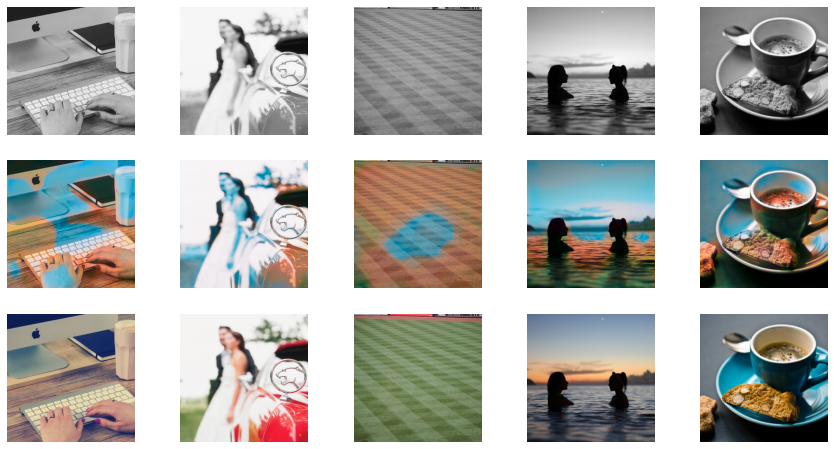


Epoch 17/20
Iteration 200/840
loss_D_fake: 0.68903
loss_D_real: 0.68163
loss_D: 0.68533
loss_G_GAN: 0.73746
loss_G_L1: 0.11241
loss_G: 0.84988


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5227 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


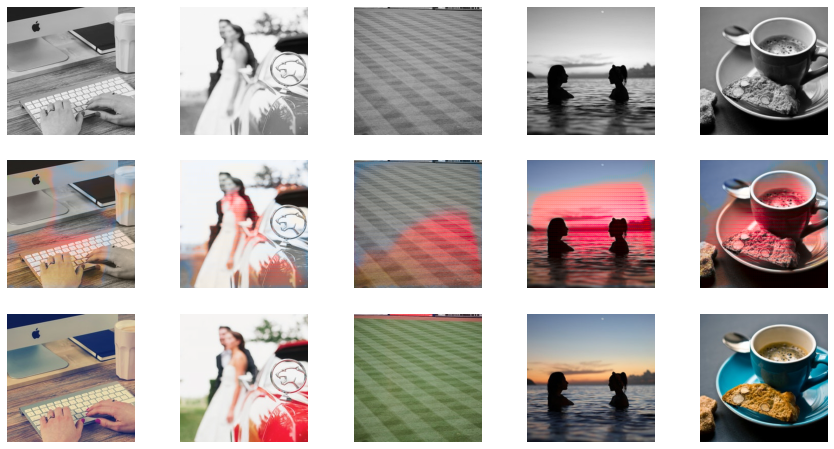


Epoch 17/20
Iteration 400/840
loss_D_fake: 0.68898
loss_D_real: 0.68844
loss_D: 0.68871
loss_G_GAN: 0.73549
loss_G_L1: 0.10996
loss_G: 0.84545


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1907 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2120 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


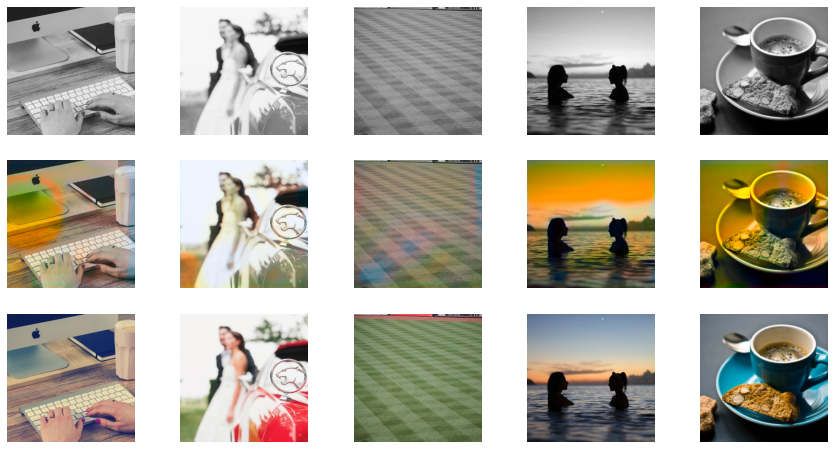


Epoch 17/20
Iteration 600/840
loss_D_fake: 0.69027
loss_D_real: 0.68956
loss_D: 0.68991
loss_G_GAN: 0.73210
loss_G_L1: 0.11027
loss_G: 0.84238


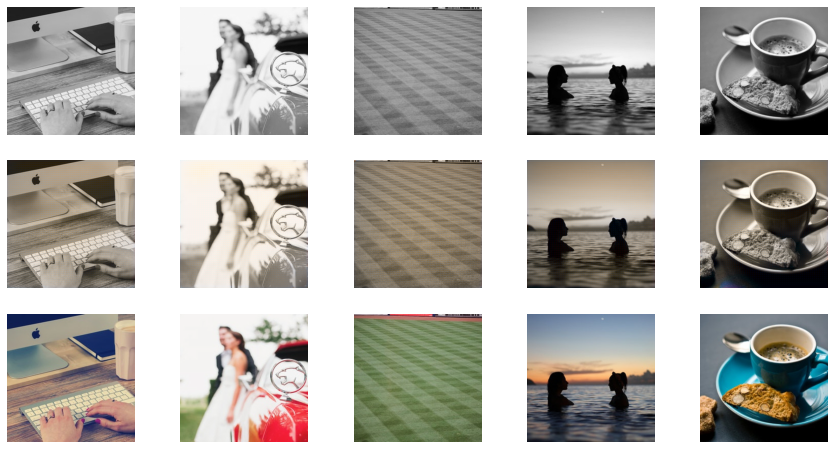


Epoch 17/20
Iteration 800/840
loss_D_fake: 0.69038
loss_D_real: 0.69063
loss_D: 0.69050
loss_G_GAN: 0.72982
loss_G_L1: 0.10988
loss_G: 0.83970


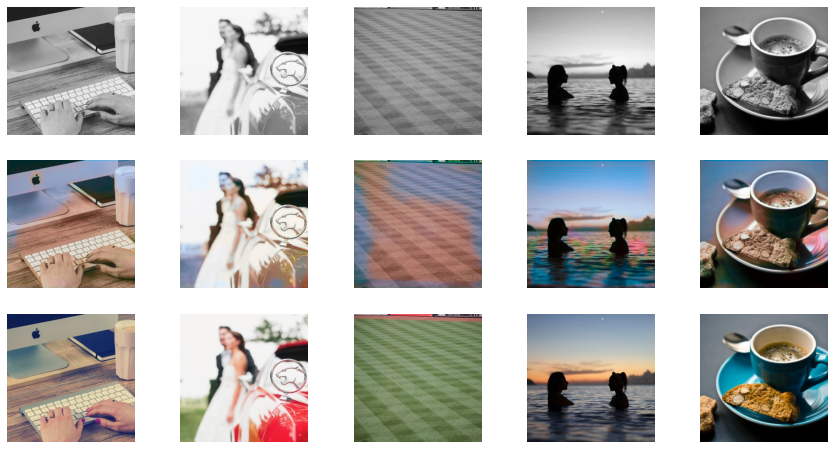


Epoch 18/20
Iteration 200/840
loss_D_fake: 0.68696
loss_D_real: 0.68797
loss_D: 0.68746
loss_G_GAN: 0.73637
loss_G_L1: 0.10793
loss_G: 0.84430


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3985 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


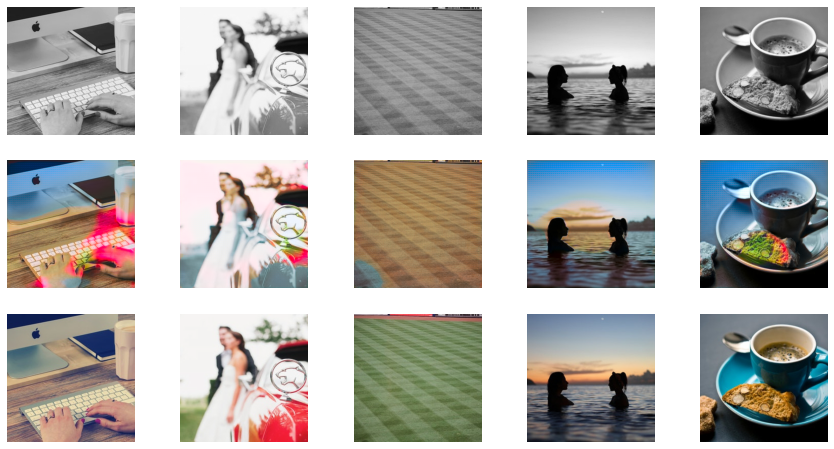


Epoch 18/20
Iteration 400/840
loss_D_fake: 0.68968
loss_D_real: 0.68722
loss_D: 0.68845
loss_G_GAN: 0.73512
loss_G_L1: 0.10926
loss_G: 0.84437


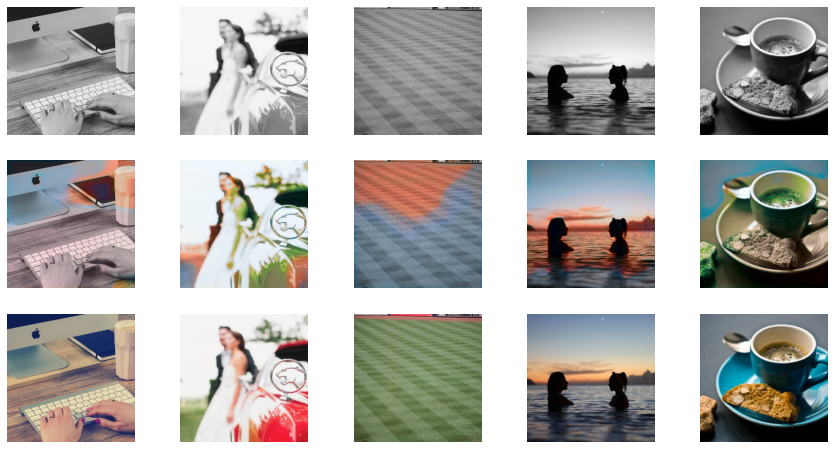


Epoch 18/20
Iteration 600/840
loss_D_fake: 0.68431
loss_D_real: 0.68112
loss_D: 0.68272
loss_G_GAN: 0.74843
loss_G_L1: 0.11132
loss_G: 0.85974


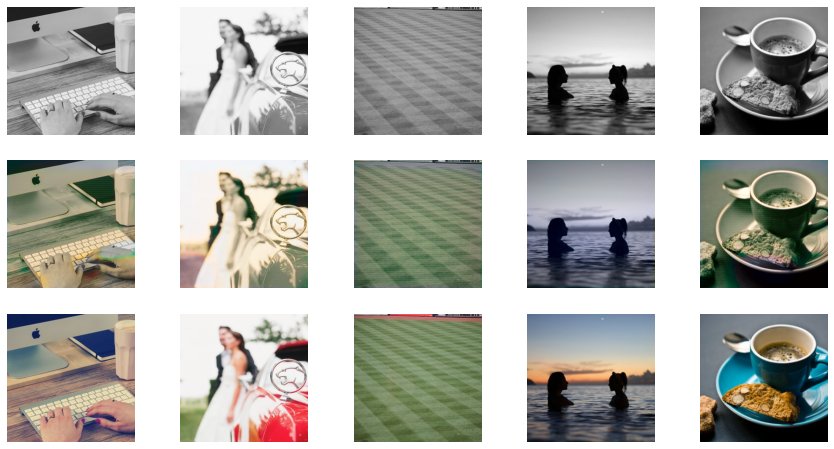


Epoch 18/20
Iteration 800/840
loss_D_fake: 0.68275
loss_D_real: 0.68315
loss_D: 0.68295
loss_G_GAN: 0.75797
loss_G_L1: 0.11178
loss_G: 0.86974


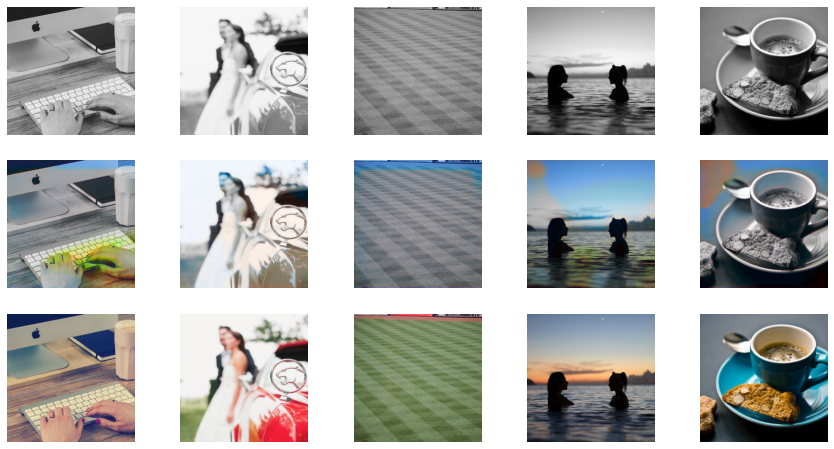


Epoch 19/20
Iteration 200/840
loss_D_fake: 0.68659
loss_D_real: 0.69018
loss_D: 0.68838
loss_G_GAN: 0.74408
loss_G_L1: 0.11333
loss_G: 0.85741


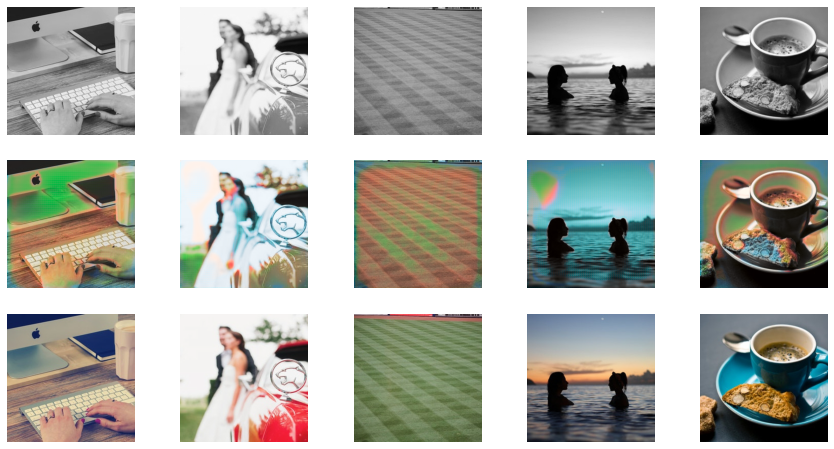


Epoch 19/20
Iteration 400/840
loss_D_fake: 0.68070
loss_D_real: 0.67929
loss_D: 0.67999
loss_G_GAN: 0.76384
loss_G_L1: 0.11353
loss_G: 0.87737


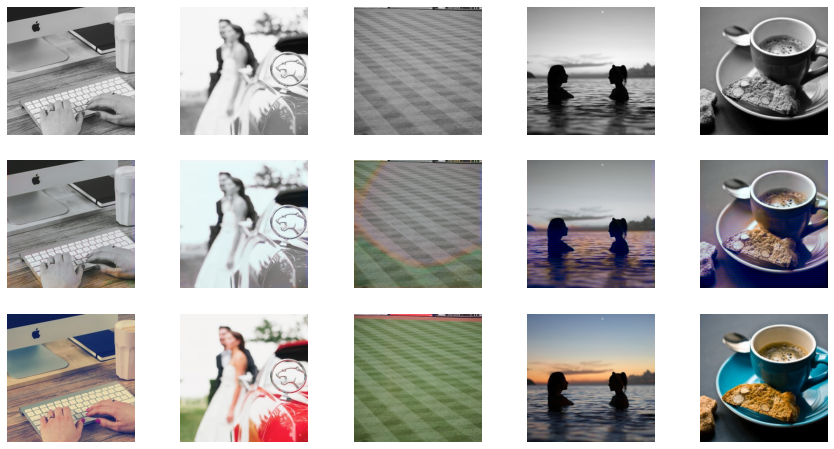


Epoch 19/20
Iteration 600/840
loss_D_fake: 0.68210
loss_D_real: 0.68335
loss_D: 0.68273
loss_G_GAN: 0.76528
loss_G_L1: 0.11253
loss_G: 0.87781


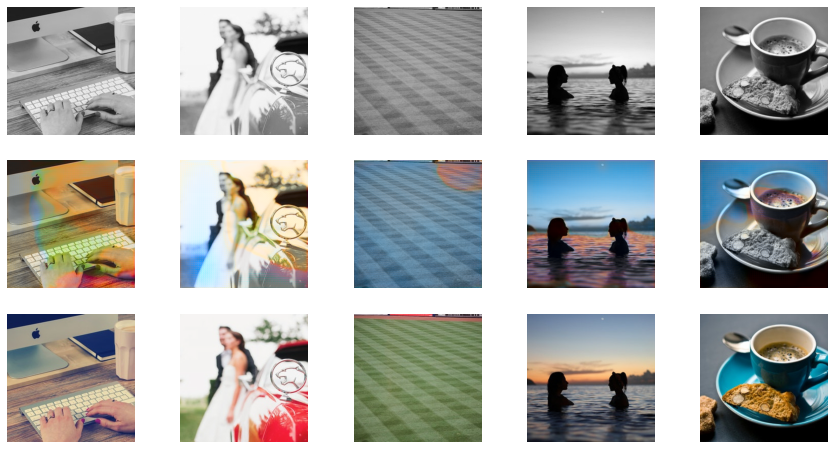


Epoch 19/20
Iteration 800/840
loss_D_fake: 0.68294
loss_D_real: 0.68361
loss_D: 0.68328
loss_G_GAN: 0.76334
loss_G_L1: 0.11154
loss_G: 0.87488


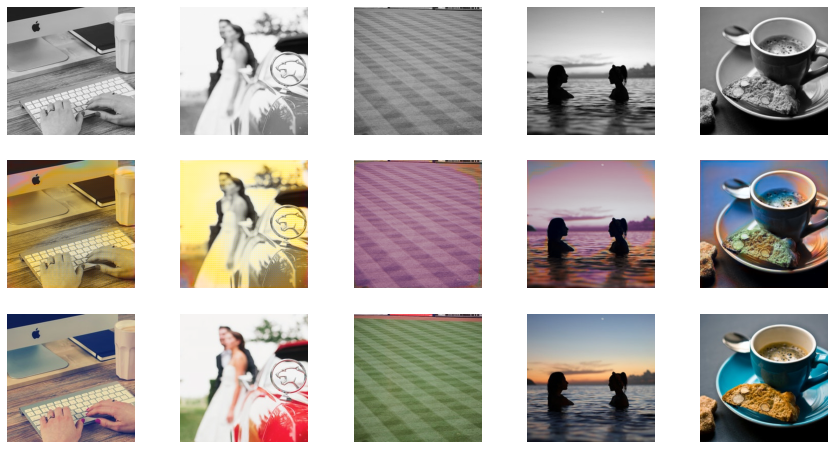


Epoch 20/20
Iteration 200/840
loss_D_fake: 0.69155
loss_D_real: 0.69062
loss_D: 0.69109
loss_G_GAN: 0.74122
loss_G_L1: 0.10952
loss_G: 0.85074


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 582 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


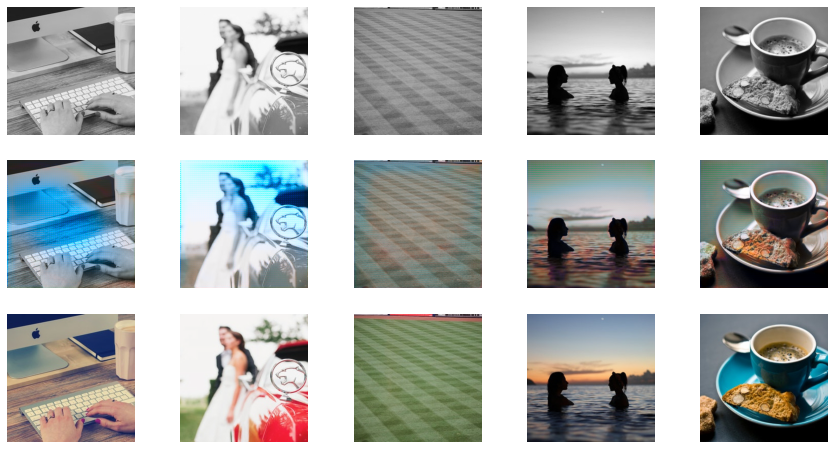


Epoch 20/20
Iteration 400/840
loss_D_fake: 0.68658
loss_D_real: 0.69080
loss_D: 0.68869
loss_G_GAN: 0.75010
loss_G_L1: 0.11015
loss_G: 0.86025


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 55 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


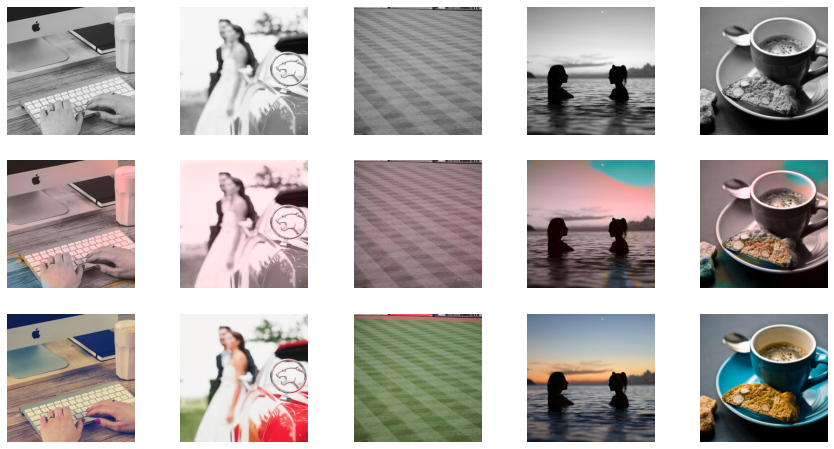


Epoch 20/20
Iteration 600/840
loss_D_fake: 0.68759
loss_D_real: 0.69264
loss_D: 0.69011
loss_G_GAN: 0.74435
loss_G_L1: 0.10834
loss_G: 0.85269


/home/superceed1/anaconda3/envs/py38torch17/lib/python3.8/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 445 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


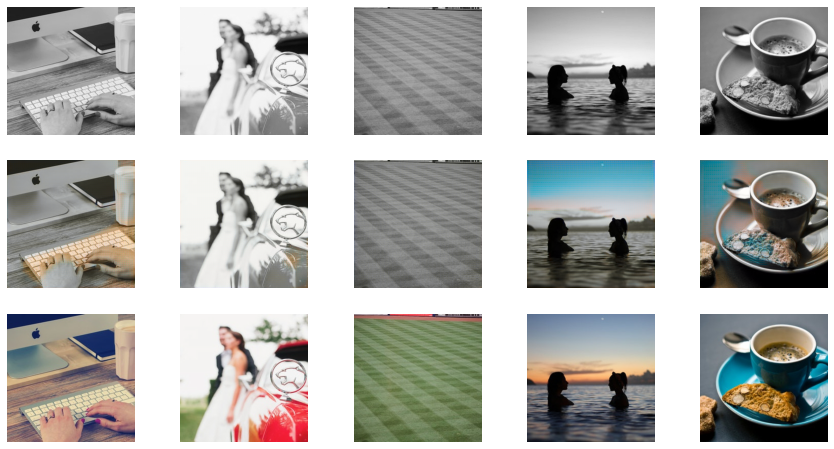


Epoch 20/20
Iteration 800/840
loss_D_fake: 0.68732
loss_D_real: 0.68996
loss_D: 0.68864
loss_G_GAN: 0.74322
loss_G_L1: 0.10861
loss_G: 0.85183


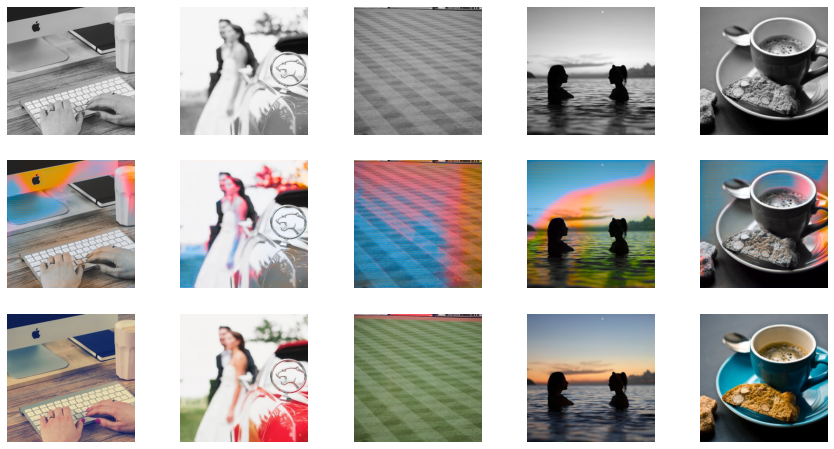

In [21]:
for e in tqdm(range(epochs)):
    loss_meter_dict = create_loss_meters()
    i = 0
    
    for train_data in tqdm(train_dataloader):
        model.setup_input(train_data)
        model.optimize()
        # function updating the log objects
        update_losses(model, loss_meter_dict, count=train_data['L'].size(0))
        
        i += 1
        if i % display_every == 0:
            validation_data = next(iter(val_dataloader))
            print(f"\nEpoch {e+1}/{epochs}")
            print(f"Iteration {i}/{len(train_dataloader)}")
            log_results(loss_meter_dict)
            visualize(model, validation_data, save=False)

In [22]:
torch.save(model.net_G.state_dict(), 'pix2pix/model/color_gen_34.pt')